## Working notebook
Topic: Liner shipping shedules and country network construction, analysis and visualizations

In [1]:
 
import numpy as np
import matplotlib.pyplot as plt
import networkx as nx
import pandas as pd
import community
import matplotlib
import matplotlib.pylab as pl
import matplotlib.gridspec as gridspec
import matplotlib.colors as mcolors
import matplotlib.patches as mpatches
from collections import Counter

import os
import json
import numpy as np
import matplotlib.pyplot as plt
import unicodedata
import pandas as pd
import seaborn as sns
from sys import getsizeof
import networkx as nx
import time
import pickle
pd.set_option('display.expand_frame_repr', False)
plt.style.use('ggplot')

In [5]:
ports = pd.read_csv("..\\ports_data_full.csv")#,index_col=1)
ports.drop(columns=['Unnamed: 0'],inplace=True)
ports.tail()

,Date,Port1,Port2,No of services,Average annual frequency,Average number of ships,Maximum number of ships,Minimum number of ships,No of operators,No of Alliances,...,Max ship size (TEU),StDevP ship size (TEU),Variance ship size (TEU),Average ship age (months),Min ship age (months),Max ship age (months),StDevP ship age (months),Variance ship age (months),Quarterly deployed capacity (TEU),Dates
1598871,2020Q4,CNYTN,BDCGP,1,52.0,4.00,4,4,1,0,...,2700,0.000000,0.000000e+00,20.000000,10,26,6.363961,40.500000,35100.000000,2020-10-01
1598872,2020Q4,JPHTD,VNHPH,4,52.0,3.75,5,3,4,0,...,1740,289.567141,8.384913e+04,161.333333,19,323,92.401780,8538.088889,76001.250000,2020-10-01
1598873,2020Q4,FRLEH,THLCH,1,52.0,17.00,17,17,2,1,...,20568,2966.371132,8.799358e+06,99.666667,41,175,32.951142,1085.777778,193718.777778,2020-10-01
1598874,2020Q4,PTSIE,ZADUR,1,52.0,9.00,9,9,1,0,...,9408,1415.360321,2.003245e+06,137.666667,52,221,62.916170,3958.444444,97554.888889,2020-10-01
1598875,2020Q4,DEHAM,PECLL,2,52.0,8.50,9,8,4,0,...,10926,2932.975402,8.602345e+06,43.153846,30,60,9.130222,83.360947,182262.888889,2020-10-01


In [83]:
def get_codes():
    os.chdir("C:\\Users\\dauly\\Desktop\\mdst\\")
    meta = pd.read_excel("C:\\Users\dauly\\Downloads\\WB & MDST - LPI\\Codes.xlsx")
    meta['CountryCode'] = meta['CountryCode'].fillna("NA")
    meta['Country'] = np.where(meta['CountryCode'] =='JE','Jersey',meta['Country'])
    meta['Country'] = np.where(meta['CountryCode'] =='GG','Guernsey',meta['Country'])
    print(meta.isnull().sum())
    m = meta.copy()
    meta = meta.set_index('UNCode')
    meta_dict = meta.to_dict('index')
    with open('port_codes_dictionary.json', 'w') as fp:
        json.dump(meta_dict, fp, sort_keys=True, indent=4)
    return meta, meta_dict,m

meta, meta_dict,m = get_codes()
print(meta_dict.values())

UNCode                  0
OldCode               223
Port                    0
CountryCode             0
Country                 0
CountryArea             0
MaritimeRegion          0
PortSeaArea(Meda)       0
Region(Meda)         1685
LatitudeDeg            84
LongitudeDeg           84
LatitudeDec           117
LongitudeDec          117
Tranship             2180
TSREgions            2180
dtype: int64
dict_values([{'OldCode': 'AJM', 'Port': 'Ajman', 'CountryCode': 'AE', 'Country': 'UAE', 'CountryArea': 'United Arab Emirates', 'MaritimeRegion': 'Arabian Gulf', 'PortSeaArea(Meda)': 'Arabian Gulf', 'Region(Meda)': nan, 'LatitudeDeg': "25°24'N", 'LongitudeDeg': "55°27'E", 'LatitudeDec': 25.4, 'LongitudeDec': 55.45, 'Tranship': nan, 'TSREgions': nan}, {'OldCode': 'ABU', 'Port': 'Abu Dhabi', 'CountryCode': 'AE', 'Country': 'UAE', 'CountryArea': 'United Arab Emirates', 'MaritimeRegion': 'Arabian Gulf', 'PortSeaArea(Meda)': 'Arabian Gulf', 'Region(Meda)': 'Abu Dhabi', 'LatitudeDeg': "24°32'N", '

In [84]:
cdict = dict(zip(list(meta['Country']),list(meta['CountryCode'])))

In [86]:
meta_p1 = meta.copy()
meta_p2 = meta.copy()

p1_cols = [x+"_port1" for x in meta_p1.columns]
p2_cols = [x+"_port2" for x in meta_p2.columns]

meta_p1.columns = p1_cols
meta_p2.columns = p2_cols

In [89]:
port1 = pd.merge(ports,meta_p1,how='left',left_on = ['Port1'], right_on=meta_p1.index)
port2 = pd.merge(port1,meta_p2,how='left',left_on = ['Port2'], right_on=meta_p2.index)
frame = port2.copy()
frame['Dates'] = pd.to_datetime(frame['Dates'])
frame['year'] = frame['Dates'].dt.year
#frame.to_csv("full_dataset.csv")

In [90]:
frame.head()

,Date,Port1,Port2,No of services,Average annual frequency,Average number of ships,Maximum number of ships,Minimum number of ships,No of operators,No of Alliances,...,MaritimeRegion_port2,PortSeaArea(Meda)_port2,Region(Meda)_port2,LatitudeDeg_port2,LongitudeDeg_port2,LatitudeDec_port2,LongitudeDec_port2,Tranship_port2,TSREgions_port2,year
0,2006Q1,AEAJM,AEAUH,6,35.0,1.0,1,1,1,0,...,Arabian Gulf,Arabian Gulf,Abu Dhabi,24°32'N,54°23'E,24.53,54.38,NaN,NaN,2006
1,2006Q1,AEAJM,AEDXB,5,34.8,1.0,1,1,1,0,...,Arabian Gulf,Arabian Gulf,Dubai,25°15'N,55°16'E,25.25,55.27,NaN,NaN,2006
2,2006Q1,AEAJM,AEJEA,6,35.0,1.0,1,1,1,0,...,Arabian Gulf,Arabian Gulf,Dubai,24°59'N,55°3'E,24.98,55.05,NaN,NaN,2006
3,2006Q1,AEAJM,AEKLF,5,31.6,1.0,1,1,1,0,...,Arabian Gulf,Arabian Gulf,NaN,25°21'N,56°22'E,25.35,56.37,Y,EAF - ISC,2006
4,2006Q1,AEAJM,AEMKH,5,36.0,1.0,1,1,1,0,...,Arabian Gulf,Arabian Gulf,Sharjah,25°22'N,55°22'E,25.37,55.37,NaN,NaN,2006


In [9]:
f2 = frame.groupby(["Port1","Port2",'year']).agg({ 'No of services':['mean'], 'Average annual frequency':['mean'],
       'Average number of ships':['mean'], 'No of operators':['mean'], 'No of Alliances':['mean'],
       'Average ship size (TEU)':['mean'],'Average ship age (months)':['mean'], 'Quarterly deployed capacity (TEU)':['mean','sum']}).reset_index()

In [10]:
fcols = [" ".join(x).strip() for x in f2.columns]
f2.columns = fcols

In [41]:
p1 = pd.merge(f2,meta_p1,how='left',left_on = ['Port1'], right_on=meta_p1.index)
p2 = pd.merge(p1,meta_p2,how='left',left_on = ['Port2'], right_on=meta_p2.index)
frame = p2.copy()

In [55]:
for d in list(frame['year'].unique()):
    data = frame[frame['year'] ==d]
    data.to_csv("all_data_{}.csv".format(str(d)))

In [56]:
data = frame[frame['year'] ==2018]
data.describe()

,year,No of services mean,Average annual frequency mean,Average number of ships mean,No of operators mean,No of Alliances mean,Average ship size (TEU) mean,Average ship age (months) mean,Quarterly deployed capacity (TEU) mean,Quarterly deployed capacity (TEU) sum,LatitudeDec_port1,LongitudeDec_port1,LatitudeDec_port2,LongitudeDec_port2
count,31682.0,31682.000000,31682.000000,31682.000000,31682.000000,31682.000000,31682.000000,31682.000000,3.168200e+04,3.168200e+04,31223.000000,31223.000000,31223.000000,31223.000000
mean,2018.0,2.201623,46.367679,5.346134,2.512846,0.196815,3571.277565,140.364605,1.135276e+05,4.292943e+05,23.952379,28.824979,23.952379,28.824979
std,0.0,4.227933,17.029154,3.492530,2.937749,0.550381,3476.955200,67.685331,3.236455e+05,1.297506e+06,23.838644,78.632559,23.838644,78.632559
min,2018.0,1.000000,6.000000,1.000000,1.000000,0.000000,14.000000,5.000000,1.200000e+02,1.820000e+02,-54.820000,-176.180000,-54.820000,-176.180000
25%,2018.0,1.000000,47.666667,2.357143,1.000000,0.000000,1033.375000,97.250000,1.241000e+04,3.602212e+04,10.420000,-13.720000,10.420000,-13.720000
50%,2018.0,1.000000,52.000000,4.250000,1.500000,0.000000,2135.000000,131.062500,3.748062e+04,1.168158e+05,29.950000,14.770000,29.950000,14.770000
75%,2018.0,2.000000,52.000000,7.823804,2.750000,0.000000,5193.333333,170.500000,1.137194e+05,3.951675e+05,39.650000,113.050000,39.650000,113.050000
max,2018.0,165.750000,730.000000,17.000000,53.000000,4.000000,20309.090909,549.500000,1.329559e+07,5.318237e+07,70.670000,179.220000,70.670000,179.220000


In [231]:
num_columns = ['No of services mean',
       'Average annual frequency mean', 'Average number of ships mean',
       'No of operators mean', 'No of Alliances mean',
       'Average ship size (TEU) mean', 'Average ship age (months) mean',
       'Quarterly deployed capacity (TEU) mean',
       'Quarterly deployed capacity (TEU) sum']

cat_columns = ['MaritimeRegion_port2']

### Convert to countries network

In [115]:
cdict_inv = {v:k for k,v in cdict.items()}
cdict_inv['US'] = "United States"
cdict_inv.get("US")

'United States'

In [54]:
#data.to_csv("all_data_2018.csv")

In [46]:
#frame.to_csv("annual_dataframe_full.csv")

In [31]:
def connected_component_subgraphs(G):
    for c in nx.connected_components(G):
        yield G.subgraph(c)

In [125]:
data = cntr[cntr['date'].dt.year==2018]

In [118]:
data

,date,source,target,weight_sum,weight_mean,weight_count,source_id,target_id
66217,2018-01-01,Albania,Algeria,11736.00,5868.000000,2,AL,DZ
66218,2018-01-01,Albania,Croatia,43849.00,21924.500000,2,AL,HR
66219,2018-01-01,Albania,Greece,11736.00,5868.000000,2,AL,GR
66220,2018-01-01,Albania,Israel,59592.00,14898.000000,4,AL,IL
66221,2018-01-01,Albania,Italy,199335.50,14238.250000,14,AL,IT
...,...,...,...,...,...,...,...,...
71711,2018-01-01,Wallis & Futuna,Marshall Islands,6540.75,2180.250000,3,WF,MH
71712,2018-01-01,Wallis & Futuna,Tuvalu,9090.75,2272.687500,4,WF,TV
71713,2018-01-01,Yemen,Djibouti,230022.00,57505.500000,4,YE,DJ
71714,2018-01-01,Yemen,Saudi Arabia,464421.50,38701.791667,12,YE,SA


In [126]:
#-Construct the complete network-#
g = nx.from_pandas_edgelist(data, source="source_id", target="target_id", 
                            edge_attr=['weight_sum', 'weight_mean', 'weight_count'])
print("# of Nodes: {}".format(g.number_of_nodes()))
print("# of Edges: {}".format(g.number_of_edges()))

# of Nodes: 179
# of Edges: 2786


In [127]:
nx.is_connected(g)

True

In [107]:
G = max(connected_component_subgraphs(g), key=len)
#nx.write_edgelist(G, "ports_all_2018.edgelist")
#nx.write_graphml(G,"ports_all_2018}.graphml")

In [108]:
print("# of Nodes: {}".format(G.number_of_nodes()))
print("# of Edges: {}".format(G.number_of_edges()))

# of Nodes: 179
# of Edges: 2786


In [140]:
#or for something that works for 1.x or 2.x
nx.set_node_attributes(G, values = cdict_inv, name='label')


In [141]:
G.nodes(data=True)

NodeDataView({'AL': {'label': 'Albania'}, 'DZ': {'label': 'Algeria'}, 'HR': {'label': 'Croatia'}, 'GR': {'label': 'Greece'}, 'IL': {'label': 'Israel'}, 'IT': {'label': 'Italy'}, 'LY': {'label': 'Libya'}, 'MT': {'label': 'Malta'}, 'ME': {'label': 'Montenegro'}, 'SI': {'label': 'Slovenia'}, 'ES': {'label': 'Melilla'}, 'TN': {'label': 'Tunisia'}, 'TR': {'label': 'Turkey'}, 'BE': {'label': 'Belgium'}, 'EG': {'label': 'Egypt'}, 'FR': {'label': 'France'}, 'DE': {'label': 'Germany'}, 'LB': {'label': 'Lebanon'}, 'MA': {'label': 'Morocco'}, 'NL': {'label': 'Netherlands'}, 'PT': {'label': 'Portugal Islands'}, 'RO': {'label': 'Romania'}, 'UA': {'label': 'Ukraine'}, 'GB': {'label': 'United Kingdom'}, 'AS': {'label': 'American Samoa'}, 'AU': {'label': 'Australia'}, 'CN': {'label': 'China'}, 'FJ': {'label': 'Fiji'}, 'PF': {'label': 'French Polynesia'}, 'JP': {'label': 'Japan'}, 'KI': {'label': 'Kiribati'}, 'MH': {'label': 'Marshall Islands'}, 'NC': {'label': 'New Caledonia'}, 'NZ': {'label': 'New Ze

Total number of Edges= 2786
Total number of Nodes= 179


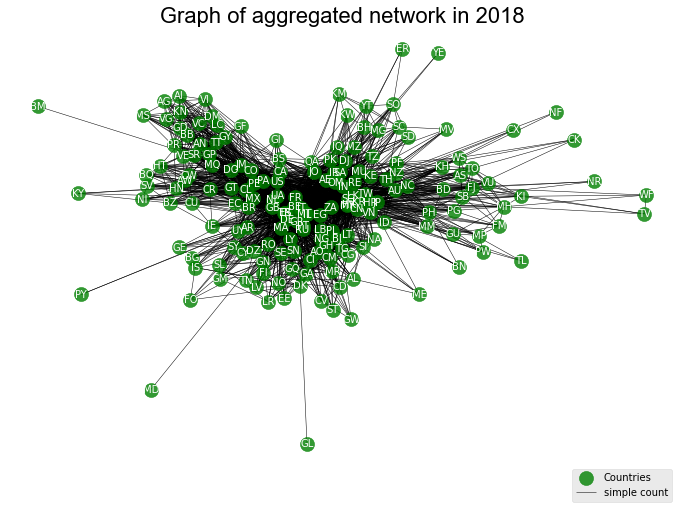

In [247]:
# nodes
options = {"node_size": 200, "alpha": 0.8}
# Position nodes using Fruchterman-Reingold force-directed algorithm
pos = nx.spring_layout(G)
# Drawing the graph
nx.draw_networkx_nodes(G, pos,  node_color="green", **options, label='Countries')
nx.draw_networkx_edges(G, pos, width=0.5,label='simple count')
nx.draw_networkx_labels(G, pos, font_size=10, font_color='white')
plt.title('Graph of aggregated network in 2018', fontsize=22, fontname='Arial')
plt.box(on=None)
plt.axis('off')
plt.legend(bbox_to_anchor=(1, 0), loc='best', ncol=1)
plt.savefig('base.png', dpi=400)

# Additional metrics
print("Total number of Edges=", len(G.edges()))
print("Total number of Nodes=", len(G.nodes()))

In [446]:
# Centrality Metrics

# Calculating Centrality metrics for the Graph

dict_degree_centrality = nx.degree_centrality(G)
dict_closeness_centrality = nx.closeness_centrality(G)
dict_eigenvector_centrality = nx.eigenvector_centrality(G)
dict_betw_centrality = nx.eigenvector_centrality(G)

In [154]:
# Top 10 nodes with the largest values of degree centrality in descending order
#for k,v in dict(Counter(dict_degree_centrality).most_common(10)).items():
 #   print(meta_dict1.get(k)," - ",meta_dict2.get(k),":",v)
    
    # Top 10 nodes with the largest values of degree centrality in descending order
for k,v in dict(Counter(dict_degree_centrality).most_common(10)).items():
    print(k," - ",cdict_inv.get(k),":",v)

GB  -  United Kingdom : 0.6067415730337078
ES  -  Melilla : 0.5955056179775281
BE  -  Belgium : 0.5955056179775281
US  -  United States : 0.5955056179775281
FR  -  France : 0.5730337078651685
NL  -  Netherlands : 0.5617977528089888
CN  -  China : 0.5561797752808989
IT  -  Italy : 0.5224719101123595
SG  -  Singapore : 0.5112359550561798
DE  -  Germany : 0.5


In [155]:
# Top 10 nodes with the largest values of closeness centrality in descending order
for k, v in dict(Counter(dict_closeness_centrality).most_common(10)).items():
    print(k," - ",cdict_inv.get(k),":",v)

GB  -  United Kingdom : 0.7035573122529645
US  -  United States : 0.7007874015748031
BE  -  Belgium : 0.6980392156862745
ES  -  Melilla : 0.6953125
CN  -  China : 0.6872586872586872
FR  -  France : 0.6846153846153846
NL  -  Netherlands : 0.6819923371647509
SG  -  Singapore : 0.6716981132075471
IT  -  Italy : 0.6617100371747212
KR  -  South Korea : 0.6592592592592592


In [157]:
# Top 10 nodes with the largest values of eigenvector centrality in descending order
for k, v in dict(Counter(dict_eigenvector_centrality).most_common(10)).items():
    print(k," - ",cdict_inv.get(k),":",v)

BE  -  Belgium : 0.18067116074872233
ES  -  Melilla : 0.1802735960849395
GB  -  United Kingdom : 0.1801815364156127
FR  -  France : 0.17684791095590777
NL  -  Netherlands : 0.17274249883885984
CN  -  China : 0.17150281664325323
US  -  United States : 0.17059288743080334
IT  -  Italy : 0.17030131159861955
DE  -  Germany : 0.16569347794809552
SG  -  Singapore : 0.1615322862059682


C:\Users\dauly\Anaconda3\envs\nx\lib\site-packages\ipykernel_launcher.py:5: MatplotlibDeprecationWarning: default base will change from np.e to 10 in 3.4.  To suppress this warning specify the base keyword argument.
  """


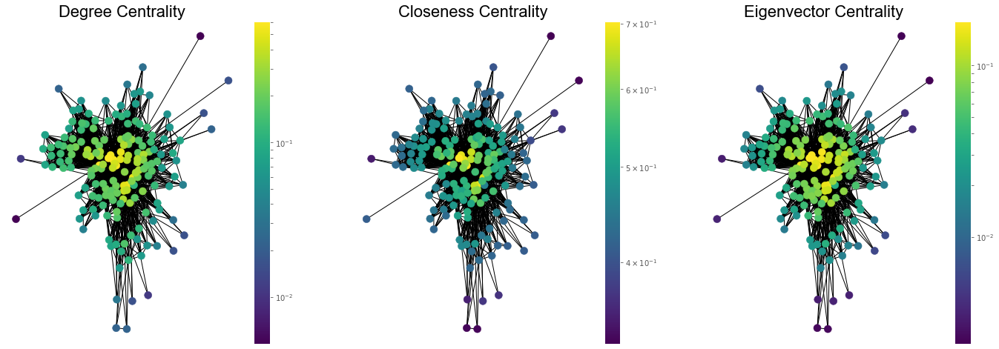

In [158]:
# Function to plot the graphs for each centrality metric
matplotlib.rcParams['figure.figsize']= [24, 8]
def draw(G, pos, lista, listb, measure_name):
    nodes=nx.draw_networkx_nodes(G, pos, node_size=100, cmap=plt.cm.viridis,node_color=lista,nodelist=listb)
    nodes.set_norm(mcolors.SymLogNorm(linthresh=0.01, linscale=1))
    edges=nx.draw_networkx_edges(G, pos)
    plt.title(measure_name, fontsize=22, fontname='Arial')
    plt.colorbar(nodes)
    plt.axis('off')

plt.subplot(1,3,1)
list_pos_values = []
for i in nx.degree_centrality(G18).values():
    list_pos_values.append(i)
    list_pos_keys=[]
for i in nx.degree_centrality(G).keys():
    list_pos_keys.append(i)
draw(G18, pos, list_pos_values, list_pos_keys, 'Degree Centrality')

plt.subplot(1,3,2)
list_pos_values=[]
for i in nx.closeness_centrality(G).values():
    list_pos_values.append(i)
    list_pos_keys=[]
for i in nx.closeness_centrality(G).keys():
    list_pos_keys.append(i)
draw(G, pos, list_pos_values, list_pos_keys, 'Closeness Centrality')

plt.subplot(1,3,3)
list_pos_values=[]
for i in nx.eigenvector_centrality(G).values():
    list_pos_values.append(i)
    list_pos_keys=[]
for i in nx.eigenvector_centrality(G).keys():
    list_pos_keys.append(i)
draw(G, pos, list_pos_values, list_pos_keys, 'Eigenvector Centrality')
plt.savefig('centrality_summary.png' , dpi=400)

In [159]:
# Starting with an initial partition of the graph and running the Louvain algorithm for Community Detection
partition=community.best_partition(G, weight='MsgCount')
print('Completed Louvain algorithm .. . . ' )
values=[partition.get(node) for node in G.nodes()]
list_com=partition.values()

Completed Louvain algorithm .. . . 


In [160]:
# Creating a dictionary like {community_number:list_of_participants}
dict_nodes={}

In [161]:
# Starting with an initial partition of the graph and running the Louvain algorithm for Community Detection
partition=community.best_partition(G, weight='MsgCount')
print('Completed Louvain algorithm .. . . ' )
values=[partition.get(node) for node in G.nodes()]
list_com=partition.values()

# Creating a dictionary like {community_number:list_of_participants}
dict_nodes={}

# Populating the dictionary with items
for each_item in partition.items():
    community_num=each_item[1]
    community_node=each_item[0]
    if community_num in dict_nodes:
        value=dict_nodes.get(community_num) + ' | ' + str(community_node)
        dict_nodes.update({community_num:value})
    else:
        dict_nodes.update({community_num:community_node})

# Creating a dataframe from the diet, and getting the output into excel
community_df=pd.DataFrame.from_dict(dict_nodes, orient='index',columns=['Members'])
community_df.index.rename('Community_Num' , inplace=True)
community_df.to_csv('Community_List_snippet.csv')



Completed Louvain algorithm .. . . 


In [162]:
community_df.head()

,Members
Community_Num,
0,AL | DZ | HR | GR | IL | IT | LY | MT | ME | S...
1,ES | BE | FR | MA | PT | AO | BJ | CM | CV | C...
2,NL | GB | US | BR | MX | AI | BB | VG | CO | D...
3,AS | AU | CN | FJ | PF | JP | KI | MH | NC | N...
4,MY | RE | SG | ZA | DJ | IN | LT | MU | OM | P...


Modularity:  0.34548041458445955
Total number of Communities= 5


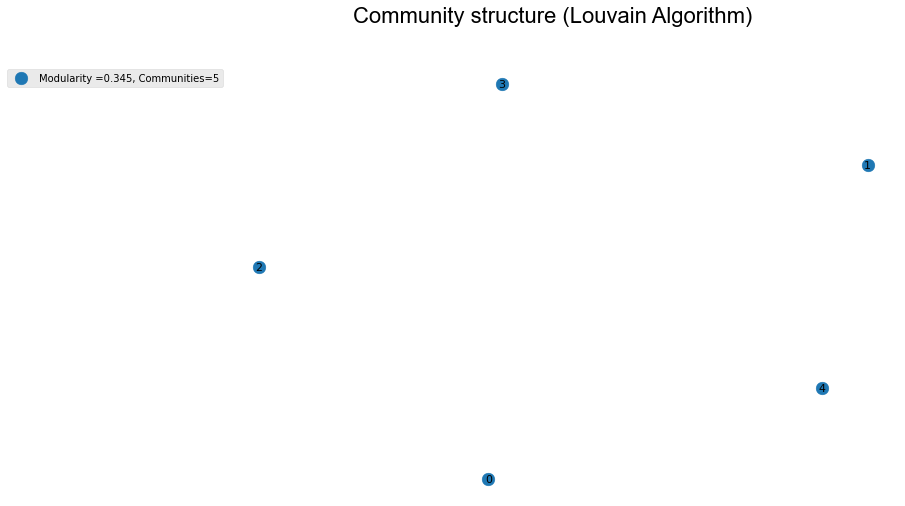

In [163]:
# Creating a new graph to represent the communities created by the Louvain algorithm
matplotlib.rcParams['figure.figsize']= [12, 8]
G_comm=nx.Graph()

# Populating the data from the node dictionary created earlier
G_comm.add_nodes_from(dict_nodes)

# Calculating modularity and the total number of communities
mod=community.modularity(partition,G)
print("Modularity: ", mod)
print("Total number of Communities=", len(G_comm.nodes()))

# Creating the Graph and also calculating Modularity
matplotlib.rcParams['figure.figsize']= [12, 8]
pos_louvain=nx.spring_layout(G_comm)
nx.draw_networkx(G_comm, pos_louvain, with_labels=True,node_size=160,font_size=11,label='Modularity =' + str(round(mod,3)) +
                    ', Communities=' + str(len(G_comm.nodes())))
plt.suptitle('Community structure (Louvain Algorithm)',fontsize=22,fontname='Arial')
plt.box(on=None)
plt.axis('off')
plt.legend(bbox_to_anchor=(0,1), loc='best', ncol=1)
plt.savefig('louvain.png',dpi=400, bbox_inches='tight')

In [164]:
community_df

,Members
Community_Num,
0,AL | DZ | HR | GR | IL | IT | LY | MT | ME | S...
1,ES | BE | FR | MA | PT | AO | BJ | CM | CV | C...
2,NL | GB | US | BR | MX | AI | BB | VG | CO | D...
3,AS | AU | CN | FJ | PF | JP | KI | MH | NC | N...
4,MY | RE | SG | ZA | DJ | IN | LT | MU | OM | P...


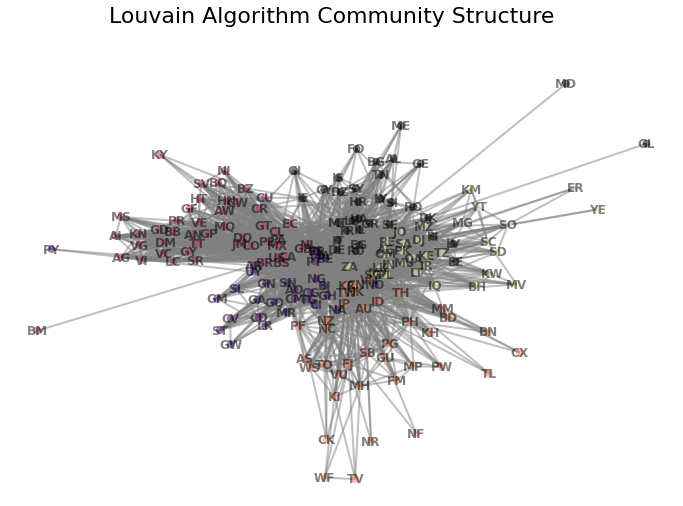

In [176]:
# Now we try to obtain the color coded graph for each community
options = { "alpha": 0.5,"edge_color":"grey", "width":2, 'font_color':'black','font_weight':'bold' }
nx.draw_networkx(G, pos, cmap=plt.get_cmap('magma'), node_color=values,node_size=50, with_labels=True,**options)
plt.suptitle('Louvain Algorithm Community Structure',fontsize=22)
plt.box(on=None)
plt.axis('off')
plt.savefig('louvain_2.png',dpi=400, bbox_inches='tight')
plt.show()

#### Comminuty structure: Girvan-Newman Algorithm

In [177]:


# Using the Girvan-Newman algorithm to create a Communicty Structure
from networkx.algorithms.community.centrality import girvan_newman
comp=girvan_newman(G)



In [178]:
# Creating a dictionary for the community number assocaited with each node
com=0
thisdict={}

# Populating the items of the dictionary
for c in next(comp):
    listed=sorted(c)
    for i in range(len(listed)):
        if listed[i] in thisdict:
            print('already found')
        else:
            thisdict.update({listed[i]: com})
        i+=1
    com+=1

values_girvan=[thisdict.get(node) for node in G.nodes()]
values_girvan

[0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0]

Total number of Communities= 2
Modularity: -6.441808060257168e-08


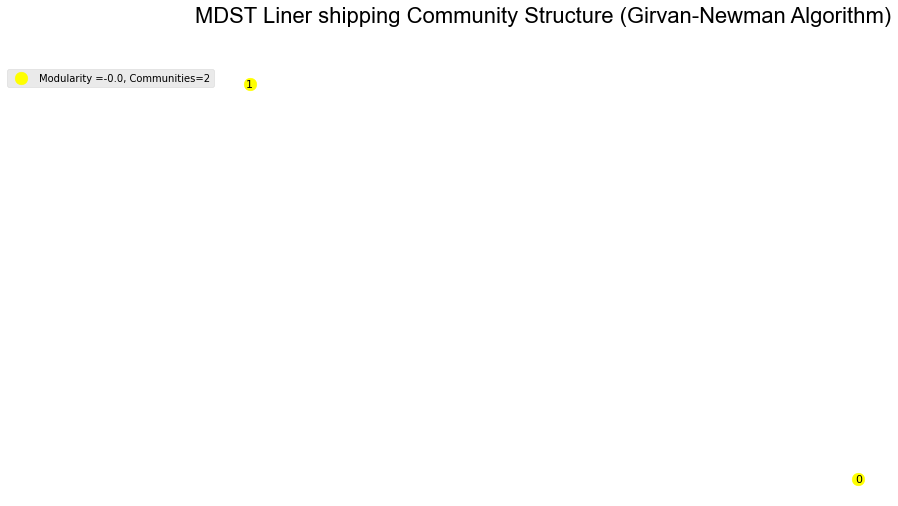

In [179]:
# Creating a dictionary like 'Community num':'List of participants'
dict_nodes_girvan={}
for each_item in thisdict.items():
    community_num=each_item[1]
    community_node=each_item[0]
    
    if community_num in dict_nodes_girvan:
        value=dict_nodes_girvan.get(community_num) + ' | ' + str(community_node)
        dict_nodes_girvan.update({community_num: value})
    else:
        dict_nodes_girvan.update({community_num: community_node})
        
# Creating the output file
community_df_girvan=pd.DataFrame.from_dict(dict_nodes_girvan, orient='index',columns=['Members'])
community_df_girvan.index.rename('Community Num', inplace=True)
community_df_girvan.to_csv('Community_List_girvan_snippet.csv')

# Creating a graph where each node represents a community
G_comm_girvan=nx.Graph()
G_comm_girvan.add_nodes_from(dict_nodes_girvan)

# Calculation of number of communities and modularity
print("Total number of Communities=", len(G_comm_girvan.nodes()))
mod_girv=community.modularity(thisdict,G)
print("Modularity:", mod_girv)

# Creation of the graph
pos_girvan=nx.spring_layout(G_comm_girvan)
nx.draw_networkx(G_comm_girvan, pos_girvan,with_labels=True,node_size=160,font_size=11, node_color='yellow',
                 label='Modularity =' + str(round(mod_girv,3)) +', Communities=' + str(len(G_comm_girvan.nodes())))
plt.suptitle('MDST Liner shipping Community Structure (Girvan-Newman Algorithm)',fontsize=22,fontname='Arial')
plt.box(on=None)
plt.axis('off')
plt.legend(bbox_to_anchor=(0,1), loc='best', ncol=1)
plt.savefig('Girvan-Newman.png', dpi=400, bbox_inches='tight')

In [180]:
# Viewing the list of communities
community_df_girvan

,Members
Community Num,
0,AE | AG | AI | AL | AN | AO | AR | AS | AU | A...
1,BM


In [181]:
#Finding the Maximal Cliques associated with teh graph
a=nx.find_cliques(G)
i=0

# For each clique, print the members and also print the total number of communities
for clique in a:
    print (clique)
    i+=1
total_comm_max_cl=i
print('Total number of communities: ',total_comm_max_cl)

['MS', 'VC', 'BB', 'AI', 'VE', 'CO', 'AN', 'DM', 'DO', 'TT', 'KN', 'GD', 'US', 'GP', 'VG']
['AL', 'IT', 'GR', 'TR', 'SI', 'HR', 'IL']
['AL', 'IT', 'GR', 'TR', 'SI', 'HR', 'MT']
['AL', 'IT', 'GR', 'TR', 'SI', 'LY', 'MT']
['AL', 'IT', 'GR', 'TR', 'ES', 'IL', 'HR']
['AL', 'IT', 'GR', 'TR', 'ES', 'MT', 'HR']
['AL', 'IT', 'GR', 'TR', 'ES', 'MT', 'TN', 'DZ', 'LY']
['AL', 'IT', 'ME', 'SI', 'HR', 'MT']
['IQ', 'OM', 'SA', 'IN', 'AE', 'SG', 'PK', 'KW', 'QA', 'KR', 'IR']
['IQ', 'OM', 'SA', 'IN', 'AE', 'SG', 'PK', 'KW', 'QA', 'BH']
['IQ', 'OM', 'SA', 'IN', 'AE', 'SG', 'PK', 'MY', 'HK', 'CN', 'LK', 'KR', 'ES', 'IT', 'IR', 'DE', 'BE']
['IQ', 'OM', 'SA', 'IN', 'AE', 'SG', 'PK', 'MY', 'HK', 'CN', 'LK', 'KR', 'ES', 'IT', 'IR', 'QA']
['IQ', 'OM', 'SA', 'IN', 'AE', 'SG', 'PK', 'MY', 'HK', 'CN', 'BH', 'QA']
['IQ', 'OM', 'SA', 'IN', 'AE', 'SG', 'TW', 'LK', 'MY', 'HK', 'CN', 'KR', 'ES', 'IT', 'IR', 'DE', 'BE']
['IQ', 'OM', 'SA', 'IN', 'AE', 'SG', 'TW', 'LK', 'MY', 'HK', 'CN', 'KR', 'ES', 'IT', 'IR', 'QA']
[

In [182]:
from math import *
import itertools as it

# Defining a circle that can be drawn around each community
def draw_circle_around_clique(clique,coords):
    dist=0
    temp_dist=0
    center=[0 for i in range(2)]
    color=next(colors)
    for a in clique:
        for b in clique:
            temp_dist=(coords[a][0]-coords[b][0])**2+(coords[a][1]-coords[b][1])**2
            if temp_dist>dist:
                dist=temp_dist
                for i in range(2):
                    center[i]=(coords[a][i]+coords[b][i])/2
    rad=dist**0.5/2
    cir=plt.Circle((center[0],center[1]),radius=rad*1.3,fill=False,color=color)
    plt.gca().add_patch(cir)
    plt.axis('scaled')
    return color

# Setting a cycle of colors,
global colors, hatches
colors=it.cycle('b')

Clique to appear :  ['MS', 'VC', 'BB', 'AI', 'VE', 'CO', 'AN', 'DM', 'DO', 'TT', 'KN', 'GD', 'US', 'GP', 'VG']
Clique to appear :  ['AL', 'IT', 'GR', 'TR', 'SI', 'HR', 'IL']
Clique to appear :  ['AL', 'IT', 'GR', 'TR', 'SI', 'HR', 'MT']
Clique to appear :  ['AL', 'IT', 'GR', 'TR', 'SI', 'LY', 'MT']
Clique to appear :  ['AL', 'IT', 'GR', 'TR', 'ES', 'IL', 'HR']
Clique to appear :  ['AL', 'IT', 'GR', 'TR', 'ES', 'MT', 'HR']
Clique to appear :  ['AL', 'IT', 'GR', 'TR', 'ES', 'MT', 'TN', 'DZ', 'LY']
Clique to appear :  ['AL', 'IT', 'ME', 'SI', 'HR', 'MT']
Clique to appear :  ['IQ', 'OM', 'SA', 'IN', 'AE', 'SG', 'PK', 'KW', 'QA', 'KR', 'IR']
Clique to appear :  ['IQ', 'OM', 'SA', 'IN', 'AE', 'SG', 'PK', 'KW', 'QA', 'BH']
Clique to appear :  ['IQ', 'OM', 'SA', 'IN', 'AE', 'SG', 'PK', 'MY', 'HK', 'CN', 'LK', 'KR', 'ES', 'IT', 'IR', 'DE', 'BE']
Clique to appear :  ['IQ', 'OM', 'SA', 'IN', 'AE', 'SG', 'PK', 'MY', 'HK', 'CN', 'LK', 'KR', 'ES', 'IT', 'IR', 'QA']
Clique to appear :  ['IQ', 'OM', '

Clique to appear :  ['RO', 'TR', 'UA', 'GR', 'IT', 'RU', 'TW', 'EG', 'MY', 'CN', 'OM', 'KR', 'ES', 'AE', 'SG', 'SA', 'IN', 'QA']
Clique to appear :  ['RO', 'TR', 'UA', 'GR', 'IT', 'RU', 'MT', 'EG', 'MY', 'CN', 'OM', 'KR', 'ES', 'AE', 'SG', 'SA', 'MA', 'LB']
Clique to appear :  ['RO', 'TR', 'UA', 'GR', 'IT', 'RU', 'MT', 'EG', 'MY', 'CN', 'OM', 'KR', 'ES', 'AE', 'SG', 'SA', 'MA', 'IN']
Clique to appear :  ['RO', 'TR', 'UA', 'GR', 'IT', 'RU', 'MT', 'EG', 'MY', 'CN', 'OM', 'KR', 'ES', 'AE', 'SG', 'SA', 'QA', 'IN']
Clique to appear :  ['RO', 'TR', 'UA', 'GR', 'IT', 'RU', 'MT', 'GE', 'BG']
Clique to appear :  ['RO', 'TR', 'UA', 'GR', 'IT', 'RU', 'MT', 'BG', 'MA']
Clique to appear :  ['RO', 'TR', 'UA', 'GR', 'IT', 'DZ', 'EG', 'ES', 'MT', 'LB', 'MA']
Clique to appear :  ['IR', 'SG', 'CN', 'MY', 'MM', 'LK', 'KR', 'HK']
Clique to appear :  ['IR', 'SG', 'CN', 'MY', 'FR', 'ES', 'EG', 'IT', 'TR', 'LK', 'JO', 'OM', 'IN', 'AE', 'SA', 'PK', 'KR', 'DE', 'BE']
Clique to appear :  ['IR', 'SG', 'CN', 'MY'

Clique to appear :  ['YT', 'RE', 'MU', 'MG', 'MZ', 'SC']
Clique to appear :  ['YT', 'RE', 'MU', 'MG', 'MZ', 'FR']
Clique to appear :  ['YT', 'RE', 'MU', 'MG', 'BE', 'FR']
Clique to appear :  ['YT', 'RE', 'MU', 'AE', 'MZ', 'SC']
Clique to appear :  ['YT', 'RE', 'MU', 'AE', 'MZ', 'FR']
Clique to appear :  ['YT', 'RE', 'MU', 'AE', 'BE', 'FR']
Clique to appear :  ['SI', 'TR', 'EG', 'IT', 'GR', 'SY', 'CY', 'LB', 'LY']
Clique to appear :  ['SI', 'TR', 'EG', 'IT', 'GR', 'CY', 'IL']
Clique to appear :  ['SI', 'TR', 'EG', 'IT', 'GR', 'SA', 'MY', 'CN', 'OM', 'KR', 'SG', 'HR', 'US', 'IL']
Clique to appear :  ['SI', 'TR', 'EG', 'IT', 'GR', 'SA', 'MY', 'CN', 'OM', 'KR', 'SG', 'HR', 'US', 'MT']
Clique to appear :  ['SI', 'TR', 'EG', 'IT', 'GR', 'SA', 'MY', 'CN', 'OM', 'KR', 'SG', 'LB', 'MT']
Clique to appear :  ['SI', 'TR', 'EG', 'IT', 'GR', 'SA', 'LY', 'MT', 'LB']
Clique to appear :  ['SI', 'TR', 'EG', 'IT', 'VN', 'HR', 'MY', 'CN', 'OM', 'KR', 'US', 'SG', 'SA', 'IL']
Clique to appear :  ['SI', 'TR'

Clique to appear :  ['GB', 'NL', 'CU', 'PA', 'CO', 'GT', 'DO', 'US', 'JM', 'CR', 'CW', 'AW', 'ES']
Clique to appear :  ['GB', 'NL', 'CU', 'PA', 'CO', 'GT', 'DO', 'US', 'JM', 'CR', 'CW', 'AW', 'HN']
Clique to appear :  ['GB', 'NL', 'CU', 'PA', 'CO', 'GT', 'DO', 'US', 'JM', 'CR', 'MX', 'DE', 'ES', 'IT']
Clique to appear :  ['GB', 'NL', 'CU', 'PA', 'CO', 'GT', 'DO', 'US', 'JM', 'CR', 'MX', 'DE', 'BZ', 'HN']
Clique to appear :  ['GB', 'NL', 'CU', 'PA', 'CO', 'GT', 'DO', 'US', 'JM', 'CA', 'ES', 'CW', 'AW']
Clique to appear :  ['GB', 'NL', 'CU', 'PA', 'CO', 'GT', 'DO', 'US', 'JM', 'CA', 'ES', 'MX', 'DE', 'IT']
Clique to appear :  ['GB', 'NL', 'CU', 'PA', 'IE', 'MX', 'DE', 'CR', 'ES', 'IT']
Clique to appear :  ['GB', 'NL', 'CU', 'PA', 'IE', 'MX', 'DE', 'CR', 'BZ']
Clique to appear :  ['GB', 'NL', 'CU', 'PA', 'IE', 'MX', 'DE', 'PT', 'ES', 'IT']
Clique to appear :  ['GB', 'NL', 'AN', 'DO', 'US', 'BS', 'CA', 'ES', 'FR']
Clique to appear :  ['GB', 'NL', 'AN', 'DO', 'US', 'BS', 'CA', 'DM']
Clique 

Clique to appear :  ['GB', 'NL', 'BE', 'FR', 'ES', 'DE', 'IT', 'CN', 'SG', 'MU', 'LK', 'MY', 'IN', 'SA', 'OM', 'AE', 'ZA', 'TW', 'HK']
Clique to appear :  ['GB', 'NL', 'BE', 'FR', 'ES', 'DE', 'IT', 'CN', 'SG', 'MU', 'LK', 'MY', 'IN', 'SA', 'OM', 'AE', 'ZA', 'TW', 'DJ']
Clique to appear :  ['GB', 'NL', 'BE', 'FR', 'ES', 'DE', 'IT', 'CN', 'SG', 'MU', 'LK', 'MY', 'IN', 'SA', 'OM', 'AE', 'PL', 'RE']
Clique to appear :  ['GB', 'NL', 'BE', 'FR', 'ES', 'DE', 'IT', 'CN', 'SG', 'MU', 'LK', 'MY', 'IN', 'SA', 'OM', 'AE', 'PL', 'DJ']
Clique to appear :  ['GB', 'NL', 'BE', 'FR', 'ES', 'DE', 'IT', 'CN', 'SG', 'MU', 'LK', 'MY', 'IN', 'SA', 'JP', 'HK', 'AU', 'TW']
Clique to appear :  ['GB', 'NL', 'BE', 'FR', 'ES', 'DE', 'IT', 'CN', 'SG', 'MU', 'LK', 'MY', 'IN', 'SA', 'JP', 'HK', 'AU', 'PT']
Clique to appear :  ['GB', 'NL', 'BE', 'FR', 'ES', 'DE', 'IT', 'CN', 'SG', 'MU', 'LK', 'MY', 'IN', 'SA', 'JP', 'HK', 'ZA', 'PT']
Clique to appear :  ['GB', 'NL', 'BE', 'FR', 'ES', 'DE', 'IT', 'CN', 'SG', 'MU', 'LK'

Clique to appear :  ['GB', 'NL', 'BE', 'FR', 'ES', 'DE', 'IT', 'CN', 'SG', 'KR', 'US', 'TR', 'MA', 'RU', 'GR', 'MY', 'SA', 'IL', 'EG', 'IN', 'OM', 'AE']
Clique to appear :  ['GB', 'NL', 'BE', 'FR', 'ES', 'DE', 'IT', 'CN', 'SG', 'KR', 'US', 'TR', 'MA', 'RU', 'GR', 'MY', 'SA', 'IL', 'EG', 'IN', 'PT']
Clique to appear :  ['GB', 'NL', 'BE', 'FR', 'ES', 'DE', 'IT', 'CN', 'SG', 'KR', 'US', 'TR', 'MA', 'RU', 'GR', 'MY', 'SA', 'MT', 'OM', 'EG', 'AE', 'IN']
Clique to appear :  ['GB', 'NL', 'BE', 'FR', 'ES', 'DE', 'IT', 'CN', 'SG', 'KR', 'US', 'TR', 'MA', 'RU', 'PA', 'CO', 'DO', 'CA', 'PT']
Clique to appear :  ['GB', 'NL', 'BE', 'FR', 'ES', 'DE', 'IT', 'CN', 'SG', 'KR', 'US', 'TR', 'MA', 'RU', 'PA', 'CO', 'DO', 'MT']
Clique to appear :  ['GB', 'NL', 'BE', 'FR', 'ES', 'DE', 'IT', 'CN', 'SG', 'KR', 'US', 'TR', 'ZA', 'LK', 'EG', 'MY', 'IN', 'SA', 'PK', 'OM', 'AE']
Clique to appear :  ['GB', 'NL', 'BE', 'FR', 'ES', 'DE', 'IT', 'CN', 'SG', 'KR', 'US', 'TR', 'ZA', 'LK', 'EG', 'MY', 'IN', 'SA', 'PT']
C

Clique to appear :  ['GB', 'NL', 'BE', 'FR', 'ES', 'DE', 'IT', 'CN', 'SG', 'KR', 'US', 'HK', 'MY', 'UY', 'PT', 'AR', 'BR', 'ZA']
Clique to appear :  ['GB', 'NL', 'BE', 'FR', 'ES', 'DE', 'IT', 'CN', 'SG', 'KR', 'US', 'HK', 'MY', 'AR', 'PT', 'JP', 'ZA']
Clique to appear :  ['GB', 'NL', 'BE', 'FR', 'ES', 'DE', 'IT', 'CN', 'SG', 'KR', 'US', 'HK', 'MX', 'TW', 'CA', 'PA', 'BS', 'DO']
Clique to appear :  ['GB', 'NL', 'BE', 'FR', 'ES', 'DE', 'IT', 'CN', 'SG', 'KR', 'US', 'HK', 'MX', 'TW', 'CA', 'PA', 'CO', 'JP']
Clique to appear :  ['GB', 'NL', 'BE', 'FR', 'ES', 'DE', 'IT', 'CN', 'SG', 'KR', 'US', 'HK', 'MX', 'TW', 'CA', 'PA', 'CO', 'JM', 'DO']
Clique to appear :  ['GB', 'NL', 'BE', 'FR', 'ES', 'DE', 'IT', 'CN', 'SG', 'KR', 'US', 'HK', 'MX', 'TW', 'CA', 'AE', 'SA', 'BS']
Clique to appear :  ['GB', 'NL', 'BE', 'FR', 'ES', 'DE', 'IT', 'CN', 'SG', 'KR', 'US', 'HK', 'MX', 'TW', 'CA', 'AE', 'SA', 'JP']
Clique to appear :  ['GB', 'NL', 'BE', 'FR', 'ES', 'DE', 'IT', 'CN', 'SG', 'KR', 'US', 'HK', 'MX'

Clique to appear :  ['GB', 'NL', 'BE', 'FR', 'ES', 'DE', 'IT', 'CN', 'SG', 'CI', 'MY', 'PT', 'NG', 'RU', 'PL']
Clique to appear :  ['GB', 'NL', 'BE', 'FR', 'ES', 'DE', 'IT', 'DZ', 'GR', 'TR', 'EG', 'MA', 'LB', 'PT']
Clique to appear :  ['GB', 'NL', 'BE', 'FR', 'ES', 'DE', 'IT', 'DZ', 'GR', 'TR', 'EG', 'MA', 'LB', 'MT']
Clique to appear :  ['GB', 'NL', 'BE', 'FR', 'ES', 'DE', 'IT', 'GN', 'MA', 'PT', 'TR', 'RU', 'EG']
Clique to appear :  ['GB', 'NL', 'BE', 'FR', 'ES', 'DE', 'IT', 'GN', 'MA', 'PT', 'RU', 'BJ', 'CI', 'TG']
Clique to appear :  ['GB', 'NL', 'BE', 'FR', 'ES', 'DE', 'IT', 'GN', 'MA', 'PT', 'RU', 'BJ', 'EG']
Clique to appear :  ['GB', 'NL', 'BE', 'FR', 'ES', 'DE', 'IT', 'GN', 'MA', 'PT', 'SN', 'AR', 'UY', 'BR']
Clique to appear :  ['GB', 'NL', 'BE', 'FR', 'ES', 'DE', 'IT', 'GN', 'MA', 'PT', 'SN', 'BJ', 'EG']
Clique to appear :  ['GB', 'NL', 'BE', 'FR', 'ES', 'DE', 'IT', 'GN', 'MA', 'PT', 'SN', 'BJ', 'CI', 'TG']
Clique to appear :  ['GB', 'NL', 'BE', 'FR', 'ES', 'DE', 'IT', 'GN'

Clique to appear :  ['GB', 'NL', 'BE', 'FR', 'VN', 'CN', 'SG', 'DE', 'IT', 'MY', 'US', 'KR', 'RU', 'TW', 'TG', 'BJ']
Clique to appear :  ['GB', 'NL', 'BE', 'FR', 'VN', 'CN', 'SG', 'DE', 'IT', 'MY', 'US', 'KR', 'RU', 'MT', 'TR', 'EG', 'OM', 'IN', 'AE', 'SA']
Clique to appear :  ['GB', 'NL', 'BE', 'FR', 'VN', 'CN', 'SG', 'DE', 'IT', 'MY', 'US', 'GH', 'BJ', 'TW', 'LK', 'TG']
Clique to appear :  ['GB', 'NL', 'BE', 'FR', 'VN', 'CN', 'SG', 'DE', 'IT', 'MY', 'US', 'GH', 'BJ', 'TW', 'LK', 'AE', 'HK', 'IN']
Clique to appear :  ['GB', 'NL', 'BE', 'FR', 'VN', 'CN', 'SG', 'DE', 'IT', 'MY', 'US', 'GH', 'BJ', 'TW', 'RU', 'TG']
Clique to appear :  ['GB', 'NL', 'BE', 'FR', 'VN', 'CN', 'SG', 'DE', 'IT', 'MY', 'US', 'GH', 'BJ', 'TW', 'RU', 'AE', 'HK', 'IN']
Clique to appear :  ['GB', 'NL', 'BE', 'VE', 'CO', 'PA', 'DO', 'ES', 'US', 'JM', 'GP', 'TT', 'GY', 'SR']
Clique to appear :  ['GB', 'NL', 'BE', 'VE', 'CO', 'PA', 'DO', 'ES', 'US', 'JM', 'MX', 'TT', 'GY', 'SR']
Clique to appear :  ['GB', 'NL', 'BE', '

Clique to appear :  ['GB', 'GQ', 'ES', 'BE', 'NO', 'RU', 'PL']
Clique to appear :  ['GB', 'CM', 'FR', 'ES', 'BE', 'DE', 'GN', 'BJ', 'TG', 'IT', 'MA', 'CI', 'PT', 'RU']
Clique to appear :  ['GB', 'CM', 'FR', 'ES', 'BE', 'DE', 'GN', 'BJ', 'TG', 'IT', 'MA', 'CI', 'PT', 'SN']
Clique to appear :  ['GB', 'CM', 'FR', 'ES', 'BE', 'DE', 'GN', 'BJ', 'TG', 'IT', 'MA', 'CI', 'GH', 'RU']
Clique to appear :  ['GB', 'CM', 'FR', 'ES', 'BE', 'DE', 'GN', 'BJ', 'TG', 'IT', 'MA', 'CI', 'GH', 'SN']
Clique to appear :  ['GB', 'CM', 'FR', 'ES', 'BE', 'DE', 'CN', 'NG', 'SG', 'MY', 'BJ', 'TG', 'PT', 'MA', 'KR', 'CG', 'LK']
Clique to appear :  ['GB', 'CM', 'FR', 'ES', 'BE', 'DE', 'CN', 'NG', 'SG', 'MY', 'BJ', 'TG', 'PT', 'MA', 'KR', 'CG', 'AO']
Clique to appear :  ['GB', 'CM', 'FR', 'ES', 'BE', 'DE', 'CN', 'NG', 'SG', 'MY', 'BJ', 'TG', 'PT', 'MA', 'KR', 'US', 'LK', 'IT']
Clique to appear :  ['GB', 'CM', 'FR', 'ES', 'BE', 'DE', 'CN', 'NG', 'SG', 'MY', 'BJ', 'TG', 'PT', 'MA', 'KR', 'US', 'RU', 'IT']
Clique to app

Clique to appear :  ['KN', 'DO', 'AN', 'US', 'BB', 'CO', 'TT', 'GP', 'VC', 'JM', 'GD', 'DM', 'VE']
Clique to appear :  ['KN', 'DO', 'AN', 'US', 'BB', 'CO', 'TT', 'GP', 'SR', 'GY', 'JM', 'LC']
Clique to appear :  ['KN', 'DO', 'AN', 'US', 'BB', 'CO', 'TT', 'GP', 'SR', 'GY', 'JM', 'VE']
Clique to appear :  ['FJ', 'CN', 'KR', 'AU', 'TW', 'NZ', 'JP', 'NC', 'HK', 'TH', 'US', 'SG']
Clique to appear :  ['FJ', 'CN', 'KR', 'AU', 'TW', 'NZ', 'JP', 'CA', 'US', 'SG', 'TH', 'HK']
Clique to appear :  ['KH', 'TW', 'MY', 'HK', 'CN', 'KR', 'VN', 'JP', 'SG', 'TH']


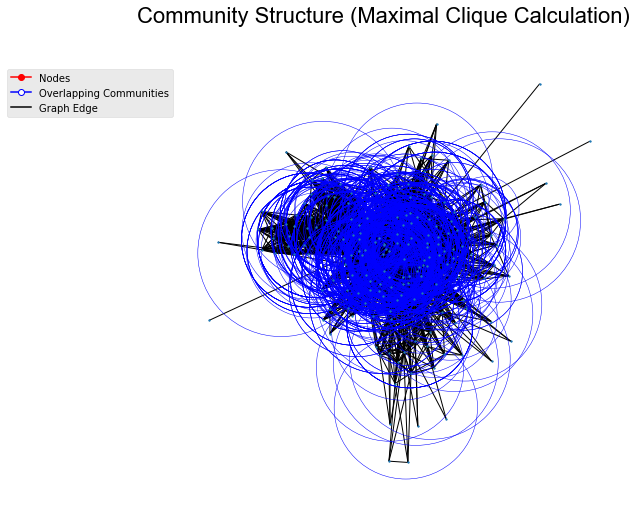

In [184]:
# Remove "len(clique)>2" if you're interested in maxcliques with 2 edges
cliques=[clique for clique in nx.find_cliques(G) if len(clique)>2]

# Draw the graph
nx.draw_networkx(G,pos, node_size=3, with_labels=False)
for clique in cliques:
    print("Clique to appear : ",clique)
    nx.draw_networkx_nodes(G,pos,nodelist=clique,node_color=draw_circle_around_clique(clique,pos),node_size=1000, alpha=0)
plt.suptitle('Community Structure (Maximal Clique Calculation)',fontsize=22, fontname='Arial')
plt.box(on=None)
plt.axis('off')
         
red_patch=mpatches.Patch(color='r', label='Nodes')
#blue_patch = plt.Circle(color='b', label='Overlapping Communities', fill=False)

red_patch=plt.Line2D([],[], color="red", marker='o', markerfacecolor="red",label='Nodes')
blue_patch=plt.Line2D([],[], color="blue", marker='o', markerfacecolor='white',label='Overlapping Communities')
black_patch=plt.Line2D([],[], color="black",label='Graph Edge')
plt.legend(handles=[red_patch,blue_patch, black_patch],bbox_to_anchor=(0,1), loc='best', ncol=1)
plt.savefig('Cliques.png',dpi=400, bbox_inches='tight')
plt.show()

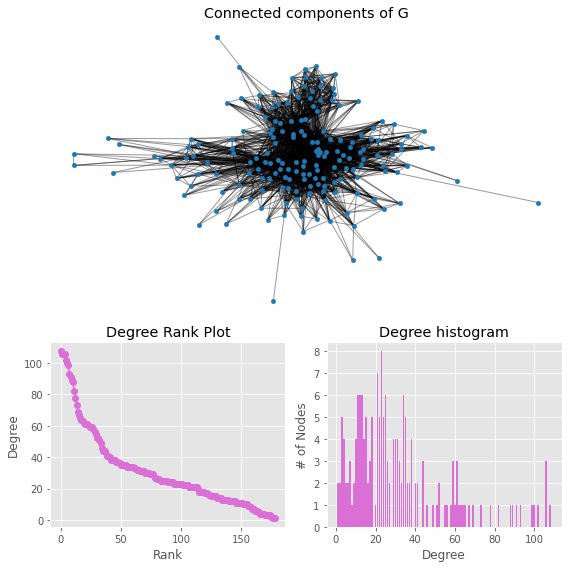

In [188]:

degree_sequence = sorted([d for n, d in G.degree()], reverse=True)
dmax = max(degree_sequence)

fig = plt.figure("Degree of a  graph", figsize=(8, 8))
# Create a gridspec for adding subplots of different sizes
axgrid = fig.add_gridspec(5, 4)

ax0 = fig.add_subplot(axgrid[0:3, :])
Gcc = G.subgraph(sorted(nx.connected_components(G), key=len, reverse=True)[0])
pos = nx.spring_layout(Gcc, seed=10396953)
nx.draw_networkx_nodes(Gcc, pos, ax=ax0, node_size=20)
nx.draw_networkx_edges(Gcc, pos, ax=ax0, alpha=0.4)
ax0.set_title("Connected components of G")
ax0.set_axis_off()

ax1 = fig.add_subplot(axgrid[3:, :2])
ax1.plot(degree_sequence, "b-", marker="o", color='orchid')
ax1.set_title("Degree Rank Plot")
ax1.set_ylabel("Degree")
ax1.set_xlabel("Rank")

ax2 = fig.add_subplot(axgrid[3:, 2:])
ax2.bar(*np.unique(degree_sequence, return_counts=True), color='orchid')
ax2.set_title("Degree histogram")
ax2.set_xlabel("Degree")
ax2.set_ylabel("# of Nodes")

fig.tight_layout()
plt.show()

In [128]:
print(len(cliques))

33588


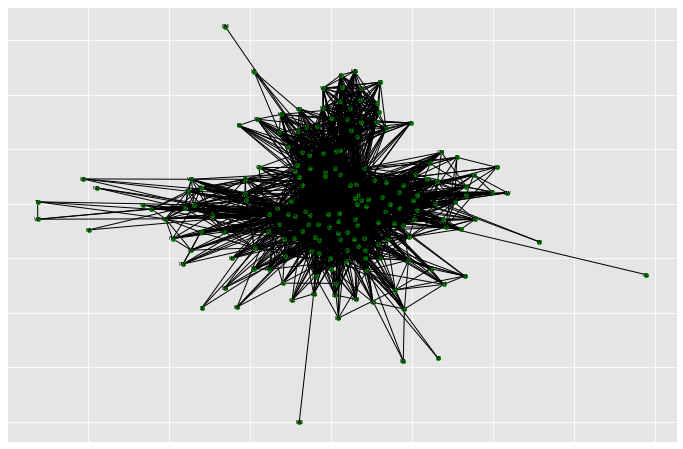

In [189]:
nx.draw_networkx(G, pos,node_color='green', node_size=20, label='Participants', font_size=5)
plt.savefig('nodes.png',dpi=400)

In [194]:

#handling data
import pandas as pd
import numpy as np
from scipy import stats
from operator import itemgetter

#handling information
import re
import json

#handling plots
import matplotlib.pyplot as plt
import seaborn as sns

#for network creation
import networkx as nx

In [191]:
print(f"There are {G.number_of_nodes()} nodes and {G.number_of_edges()} edges present in the Graph")

degrees = [val for (node, val) in G.degree()]


print(f"The maximum degree of the Graph is {np.max(degrees)}")   
print(f"The minimum degree of the Graph is {np.min(degrees)}")


print(f"The average degree of the nodes in the Graph is {np.mean(degrees):.1f}")  
print(f"The most frequent degree of the nodes found in the Graph is {stats.mode(degrees)[0][0]}")



There are 179 nodes and 2786 edges present in the Graph


In [92]:
cntr = frame.groupby(['year','Country_port1','Country_port2']).agg({'Quarterly deployed capacity (TEU)':['sum','mean','count']}).reset_index()

cntr.columns = ['date','source','target','weight_sum','weight_mean','weight_count']
cntr['source_id'] = cntr['source'].map(cdict)
cntr['target_id'] = cntr['target'].map(cdict)

An undirected graph is connected if, for every pair of nodes, there is a path between them. For that to happen, most of the nodes should have at least a degree of two, except for those denominated leaves which have a degree of 1. From the characteristics of the Graph, we can suspect that the graph is not connected. In order to confirm these, we can use nx.is_connected.

In [196]:
if nx.is_connected(G):
    print("The graph is connected")
else:
    print("The graph is not connected")

The graph is connected


Now, that we confirm that our Graph is not connected, we can check how many connected components it has:

In [198]:
print(f"There are {nx.number_connected_components(G)} connected components in the Graph")

There are 1 connected components in the Graph


Clustering and transitivity measure the tendency for nodes to cluster together or for edges to form triangles. In our context, they are measures of the extent to which the users interacting with one particular user tend to interact with each other as well. The difference is that transitivity weights nodes with a large degree higher.  The clustering coefficient, a measure of the number of triangles in a graph, is calculated as the number of triangles connected to node i divided by the number of sets of two edges connected to node i (Triple nodes). While the transitivity coefficient is calculated as 3 multiply by the number of triangles in the network divided by the number of connected triples of nodes in the network. These two parameters are very important when analyzing social networks because it gives us an insight into how users tend to create tightly knot groups characterized by relatively high-dense ties.


In [203]:
print(f"The average clustering coefficient is {nx.average_clustering(G)} in the largest subgraph")
print(f"The transitivity of the largest subgraph is {nx.transitivity(G)}")

The average clustering coefficient is 0.7157815297313441 in the largest subgraph
The transitivity of the largest subgraph is 0.49638703195641254




After that, we'll investigate some summary statistics, particularly related to distance, or how far away one node is from another random node. Diameter represents the maximum distance between any pair of nodes while the average distance tells us the average distance between any two nodes in the network.


In [204]:
print(f"The diameter of our Graph is {nx.diameter(G)}")
print(f"The average distance between any two nodes is {nx.average_shortest_path_length(G):.2f}")

The diameter of our Graph is 4
The average distance between any two nodes is 2.06


Now, we are going to focus on network centrality which captures the importance of a node's position in the network considering: degree on the assumption that an important node will have many connections, closeness on the assumption that important nodes are close to other nodes, and finally, betweenness on the assumption that important nodes are well situated and connect other nodes. For this, we are going to use the following functions degree_centrality, closenness_centrality and betwenness_centrality, all which return a list of each node and its centrality score. We will particularly capture the node with the best score in each one.

In [205]:
graph_centrality = nx.degree_centrality(G)

max_de = max(graph_centrality.items(), key=itemgetter(1))

graph_closeness = nx.closeness_centrality(G)

max_clo = max(graph_closeness.items(), key=itemgetter(1))

graph_betweenness = nx.betweenness_centrality(G, normalized=True, endpoints=False)

max_bet = max(graph_betweenness.items(), key=itemgetter(1))

print(f"the node with id {max_de[0]} has a degree centrality of {max_de[1]:.2f} which is the maximum of the Graph")
print(f"the node with id {max_clo[0]} has a closeness centrality of {max_clo[1]:.2f} which is the maximum of the Graph")
print(f"the node with id {max_bet[0]} has a betweenness centrality of {max_bet[1]:.2f} which is the maximum of the Graph")

the node with id GB has a degree centrality of 0.61 which is the maximum of the Graph
the node with id GB has a closeness centrality of 0.70 which is the maximum of the Graph
the node with id US has a betweenness centrality of 0.10 which is the maximum of the Graph


Now, we can get to see how the Graph looks like. For that, we will use nx.drawing.layout to apply node positioning algorithms for the graph drawing. Specifically, we will use spring_layout that uses force-directed graph drawing which purpose is to position the nodes in two-dimensional space so that all the edges are of equal length and as few crossing edges as possible. It achieves this by assigning forces among the set of edges and nodes based on their relative positions and then uses this to simulate the motion of the edges and nodes. One of the parameters that we can adjust is k, the optimal distance between nodes; as we increase the value, the nodes will farther apart. Once, that we got the positions, we are also going to create a special list so that we can draw the two nodes with higher centrality that we found in different colors to highlight them.

In [228]:
node_and_degree = G.degree()
colors_central_nodes = ['orange', 'red','blue']
central_nodes = ['GB', 'US', 'CN']

In [229]:
pos = nx.spring_layout(G, k=0.05)

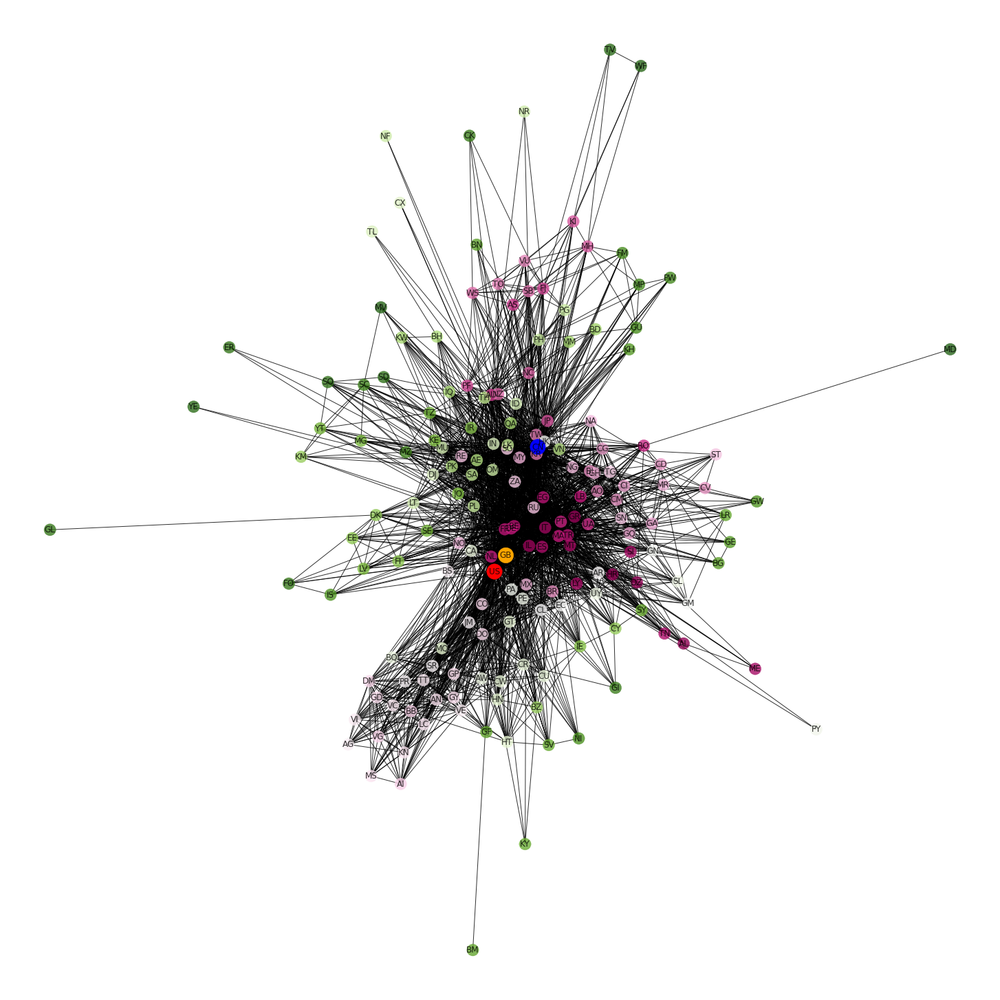

In [232]:
plt.figure(figsize = (20,20))
nx.draw(G, pos=pos, node_color=range(179), cmap=plt.cm.PiYG, edge_color="black", linewidths=0.3
        , node_size=300, alpha=0.8, with_labels=True)
nx.draw_networkx_nodes(G, pos=pos, nodelist=central_nodes, node_size=500, node_color=colors_central_nodes)
plt.savefig('graphfinal.png')
plt.show()



In [241]:
node_and_degree = G.degree()
dict(node_and_degree)

{'AL': 12,
 'DZ': 21,
 'HR': 23,
 'GR': 49,
 'IL': 38,
 'IT': 93,
 'LY': 25,
 'MT': 51,
 'ME': 5,
 'SI': 21,
 'ES': 106,
 'TN': 13,
 'TR': 62,
 'BE': 106,
 'EG': 63,
 'FR': 102,
 'DE': 89,
 'LB': 33,
 'MA': 78,
 'NL': 100,
 'PT': 69,
 'RO': 24,
 'UA': 35,
 'GB': 108,
 'AS': 16,
 'AU': 52,
 'CN': 99,
 'FJ': 29,
 'PF': 22,
 'JP': 60,
 'KI': 12,
 'MH': 20,
 'NC': 29,
 'NZ': 35,
 'WS': 15,
 'SB': 24,
 'KR': 88,
 'TW': 73,
 'TO': 17,
 'US': 106,
 'VU': 18,
 'AO': 37,
 'BJ': 38,
 'BR': 41,
 'CM': 34,
 'CV': 14,
 'CD': 18,
 'CG': 32,
 'CI': 30,
 'GQ': 25,
 'GA': 25,
 'GH': 36,
 'MY': 82,
 'MR': 23,
 'MX': 55,
 'NA': 25,
 'NG': 36,
 'NO': 21,
 'RE': 32,
 'RU': 64,
 'ST': 11,
 'SN': 33,
 'SG': 91,
 'ZA': 46,
 'TG': 34,
 'AI': 17,
 'BB': 27,
 'VG': 21,
 'CO': 65,
 'DM': 24,
 'DO': 61,
 'GD': 23,
 'GP': 40,
 'GY': 26,
 'MS': 14,
 'AN': 35,
 'KN': 24,
 'LC': 25,
 'VC': 22,
 'TT': 35,
 'VI': 21,
 'VE': 31,
 'AG': 15,
 'BS': 38,
 'JM': 52,
 'PR': 23,
 'SR': 22,
 'AR': 34,
 'CL': 35,
 'EC': 34,
 'GM'

In [245]:
frame.head()

,Date,Port1,Port2,No of services,Average annual frequency,Average number of ships,Maximum number of ships,Minimum number of ships,No of operators,No of Alliances,...,MaritimeRegion_port2,PortSeaArea(Meda)_port2,Region(Meda)_port2,LatitudeDeg_port2,LongitudeDeg_port2,LatitudeDec_port2,LongitudeDec_port2,Tranship_port2,TSREgions_port2,year
0,2006Q1,AEAJM,AEAUH,6,35.0,1.0,1,1,1,0,...,Arabian Gulf,Arabian Gulf,Abu Dhabi,24°32'N,54°23'E,24.53,54.38,NaN,NaN,2006
1,2006Q1,AEAJM,AEDXB,5,34.8,1.0,1,1,1,0,...,Arabian Gulf,Arabian Gulf,Dubai,25°15'N,55°16'E,25.25,55.27,NaN,NaN,2006
2,2006Q1,AEAJM,AEJEA,6,35.0,1.0,1,1,1,0,...,Arabian Gulf,Arabian Gulf,Dubai,24°59'N,55°3'E,24.98,55.05,NaN,NaN,2006
3,2006Q1,AEAJM,AEKLF,5,31.6,1.0,1,1,1,0,...,Arabian Gulf,Arabian Gulf,NaN,25°21'N,56°22'E,25.35,56.37,Y,EAF - ISC,2006
4,2006Q1,AEAJM,AEMKH,5,36.0,1.0,1,1,1,0,...,Arabian Gulf,Arabian Gulf,Sharjah,25°22'N,55°22'E,25.37,55.37,NaN,NaN,2006


In [ ]:
H = nx.ego_graph(G, 0)
assert_true(nx.is_isomorphic(G, H))

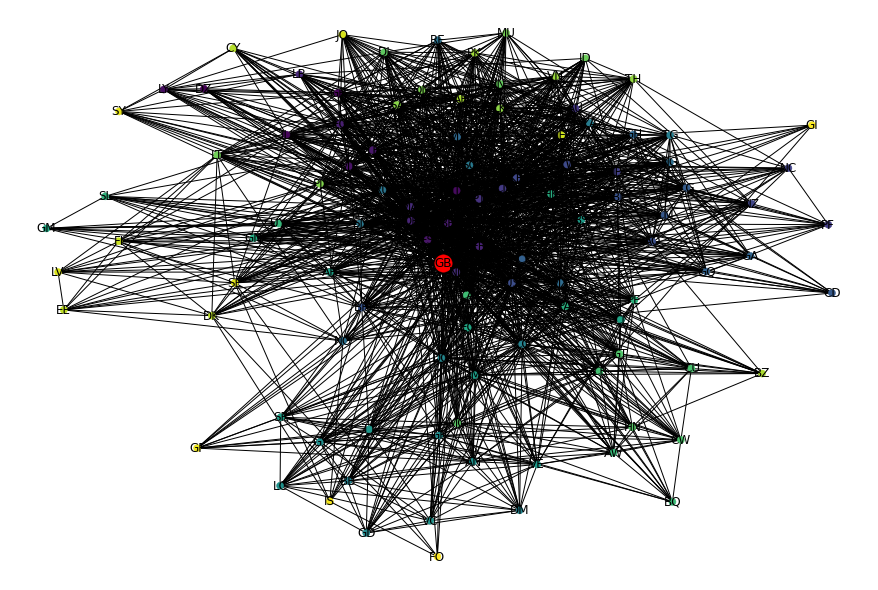

In [243]:
node_and_degree = dict(G.degree())
(largest_hub, degree) = sorted(node_and_degree.items(), key=itemgetter(1))[-1]
# Create ego graph of main hub
hub_ego = nx.ego_graph(G, largest_hub)
# Draw graph
pos = nx.spring_layout(hub_ego)
nx.draw(hub_ego, pos, node_color=range(107), node_size=50, with_labels=True)
# Draw ego as large and red
nx.draw_networkx_nodes(hub_ego, pos, nodelist=[largest_hub], node_size=300, node_color='r')
plt.savefig('largest_ego_Graph.png')
plt.show()

In [249]:
nx.average_shortest_path_length(G)

2.0626451572406

In [277]:
frame['Port1_iso'] = frame['Port1'].apply(lambda x: x[:2])
frame['Port2_iso'] = frame['Port2'].apply(lambda x: x[:2])

In [278]:
internal = frame[frame['Port1_iso']==frame['Port2_iso']]

In [274]:
frame[frame['Port1_iso1']=='GB']

,Date,Port1,Port2,No of services,Average annual frequency,Average number of ships,Maximum number of ships,Minimum number of ships,No of operators,No of Alliances,...,Region(Meda)_port2,LatitudeDeg_port2,LongitudeDeg_port2,LatitudeDec_port2,LongitudeDec_port2,Tranship_port2,TSREgions_port2,year,Port1_iso1,Port1_iso2
9026,2006Q1,GBABD,AOLAD,1,24.0,4.000000,4,4,1,0,...,NaN,8°47'S,13°16'E,-8.78,13.27,NaN,NaN,2006,GB,AO
9027,2006Q1,GBABD,AOLOB,1,24.0,4.000000,4,4,1,0,...,NaN,12°20'S,13°34'E,-12.33,13.57,NaN,NaN,2006,GB,AO
9028,2006Q1,GBABD,BEANR,3,34.0,3.666667,4,3,3,0,...,NaN,51°14'N,4°25'E,51.23,4.42,NaN,NaN,2006,GB,BE
9029,2006Q1,GBABD,CGPNR,1,24.0,4.000000,4,4,1,0,...,NaN,4°47'S,11°50'E,-4.78,11.83,NaN,NaN,2006,GB,CG
9030,2006Q1,GBABD,CMDLA,1,26.0,4.000000,4,4,1,0,...,NaN,4°3'N,9°42'E,4.05,9.70,NaN,NaN,2006,GB,CM
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1598645,2020Q4,GBPME,SNDKR,1,52.0,5.000000,5,5,1,0,...,NaN,14°41'N,17°25'W,14.68,-17.42,NaN,NaN,2020,GB,SN
1598703,2020Q4,GBABD,NOTRD,1,52.0,1.000000,1,1,1,0,...,NaN,63°26'N,10°24'E,63.43,10.40,NaN,NaN,2020,GB,NO
1598715,2020Q4,GBLGP,CNSHA,2,52.0,12.500000,13,12,5,2,...,NaN,31°15'N,121°30'E,31.25,121.50,NaN,NaN,2020,GB,CN
1598746,2020Q4,GBPME,CIABJ,1,52.0,5.000000,5,5,1,0,...,NaN,5°18'N,4°0'W,5.30,-4.00,NaN,NaN,2020,GB,CI


In [295]:
external = frame[frame['Port1_iso']!=frame['Port2_iso']]

In [280]:
intr = internal.groupby(['year','Port1_iso'])['Quarterly deployed capacity (TEU)'].sum().reset_index()
intr.groupby('year').count()

,Port1_iso,Quarterly deployed capacity (TEU)
year,,
2006,87,87
2007,92,92
2008,89,89
2009,92,92
2010,92,92
2011,93,93
2012,93,93
2013,95,95
2014,97,97


In [286]:
intr = internal.groupby(['year','Port1_iso'])['Quarterly deployed capacity (TEU)'].sum().reset_index()

intr

,year,Port1_iso,Quarterly deployed capacity (TEU)
0,2006,AE,7.297071e+06
1,2006,AN,1.248000e+05
2,2006,AO,9.785529e+05
3,2006,AR,2.418892e+06
4,2006,AU,2.665383e+07
...,...,...,...
1431,2020,VG,1.283100e+05
1432,2020,VI,3.692000e+04
1433,2020,VN,1.301365e+07
1434,2020,VU,1.445600e+05


### Metadata get country names from UNSD

In [292]:
meta_new = pd.read_csv("..\\UNSD — Methodology.csv",encoding='latin-1')
cdict = dict(zip(list(meta_new['ISO-alpha2 Code']),list(meta_new['Country or Area'])))
len(meta_new)

248

In [293]:
len(cdict.keys())

247

In [287]:
year_list = list(intr['year'].unique())

In [323]:
def degree_cal(G):
    degree_dict = dict(G.degree(G.nodes()))
    nx.set_node_attributes(G, degree_dict, 'degree')
    sorted_degree = sorted(degree_dict.items(), key=itemgetter(1), reverse=True)
    print("Top 20 nodes by degree:")
    for d in sorted_degree[:20]:
        print(d)
    mean_degree = sum([x[1] for x in sorted_degree])/len(sorted_degree)
        
    return G, mean_degree

def ecc_cal(G):
    ecc_dict = nx.eccentricity(G)
    nx.set_node_attributes(G, ecc_dict, 'eccentricity')
    sorted_degree = sorted(ecc_dict.items(), key=itemgetter(1), reverse=True)
    print("Top 20 nodes by eccentricity:")
    for d in sorted_degree[:20]:
        print(d)
    mean_ecc = sum([x[1] for x in sorted_degree])/len(sorted_degree)
        
    return G, mean_ecc

In [453]:
#list_ext = []
gdict = {}
frames_list = []
dhist_dict = {}
for y in year_list:
    new  = external[external['year']==y]
    
    cntr = new.groupby(['Port1_iso','Port2_iso']).agg({'Quarterly deployed capacity (TEU)':'sum'}).reset_index()
    cntr.columns = ['source','target','weight_sum']
    cntr['source_name'] = cntr['source'].map(cdict)
    cntr['target_name'] = cntr['target'].map(cdict)
    G = nx.from_pandas_edgelist(cntr, source="source", target="target", 
                            edge_attr='weight_sum')
   
    nx.set_node_attributes(G, values = cdict_inv, name='label')
    #adj = nx.convert_matrix.to_pandas_adjacency(G, weight="weight_sum", nonedge=np.NaN)
    G,mean_degree = degree_cal(G)
    G, ecc_mean = ecc_cal(G)
    mydict = {y: {"No_edges":G.size(),
                  "No_nodes": G.order(),
                  "Avg_degree": mean_degree,
                  "Global_Clustering": nx.average_clustering(G),
                  "Transitivity": nx.transitivity(G),
                 #"Avg_neighbor_degree": sorted(nx.average_neighbor_degree(G),reverse=True),
                  "Avg degree connectivity": nx.average_degree_connectivity(G),
                  "Avg_path_length": nx.average_shortest_path_length(G),
                  "Radius": nx.radius(G),
                  "Diameter": nx.diameter(G),
                  "eccentricity": ecc_mean, #The center is the set of nodes with eccentricity equal to radius.
                  "center": " ".join([x for x in sorted(nx.center(G),reverse=True)]),
                  "periphery": " ".join([x for x in sorted(nx.periphery(G),reverse=True)]),# periphery is the set of nodes with eccentricity equal to the diameter.
                  "density":nx.density(G),
                  "Assortativity":nx.degree_assortativity_coefficient(G),
                  "Global efficiency": nx.global_efficiency(G)}} ##  weights ignored
    dhist_dict.update({y:nx.degree_histogram(G)})
    gdict.update(mydict)
    degrees = nx.degree_centrality(G)
    closeness = nx.closeness_centrality(G, distance='weight_sum')
    betweeness = nx.betweenness_centrality(G, weight='weight_sum')
    eigs = nx.eigenvector_centrality(G, weight='weight_sum')
    
    dfn = pd.DataFrame([degrees, closeness, betweeness, eigs]).transpose()
    dfn.columns = ['degrees', 'closeness', 'betweeness', 'eigs']
    print(dfn.head())
    dfn['year'] = y
    dfn.reset_index(inplace=True, drop=False)
    df2 = pd.melt(dfn,id_vars = ['index','year'],value_name= 'value',var_name = "centrality")
    print(df2.tail())
    frames_list.append(df2)
    nx.write_gpickle(G,os.path.join("C:\\Users\\dauly\\Desktop\\mdst\\pickled","net_cntr_{}.gpickle".format(y)))

#     print(adj.head())
#     extdf = pd.DataFrame(adj.sum().reset_index())
#     extdf.columns = ['iso2','cap_sum']
#     extdf['year'] = y
#     list_ext.append(extdf)
#     adj.to_csv("adj_matrix_cntr_{}.csv".format(y))

# output = pd.DataFrame.from_dict(mydict, orient='index')
#output.to_csv("output_network_country.csv")
    
#externals = pd.concat(list_ext)
#combo = pd.merge( externals,intr, how='outer',right_on=['year',"Port1_iso"], left_on=['year',"iso2"], indicator=True) 
# print("# of Nodes: {}".format(g.number_of_nodes()))
# print("# of Edges: {}".format(g.number_of_edges())) 

Top 20 nodes by degree:
('GB', 121)
('BE', 116)
('ES', 112)
('US', 110)
('FR', 104)
('DE', 101)
('NL', 97)
('IT', 96)
('HK', 91)
('SG', 85)
('CN', 84)
('MY', 78)
('KR', 75)
('TW', 73)
('JP', 71)
('EG', 61)
('BR', 60)
('IN', 60)
('SA', 60)
('CA', 59)
Top 20 nodes by eccentricity:
('SO', 4)
('HT', 4)
('KN', 4)
('VG', 4)
('VI', 4)
('AI', 4)
('WF', 4)
('NF', 4)
('BM', 4)
('BZ', 4)
('CK', 4)
('GL', 4)
('TC', 4)
('KY', 4)
('KM', 4)
('KP', 4)
('AE', 3)
('AO', 3)
('AR', 3)
('BH', 3)
     degrees  closeness  betweeness      eigs
AE  0.320000   0.000028    0.001270  0.073783
AO  0.211429   0.000021    0.000394  0.001537
AR  0.240000   0.000027    0.002463  0.021568
BE  0.662857   0.000041    0.189134  0.103143
BH  0.080000   0.000028    0.008374  0.000932
    index  year centrality     value
699    KY  2006       eigs  0.000116
700    SC  2006       eigs  0.000238
701    ME  2006       eigs  0.000022
702    KM  2006       eigs  0.000006
703    KP  2006       eigs  0.000005
Top 20 nodes by degree

     degrees  closeness  betweeness      eigs
AE  0.344444   0.000013    0.000000  0.130146
AO  0.238889   0.000018    0.001407  0.009025
AU  0.250000   0.000025    0.068343  0.050031
BE  0.566667   0.000030    0.343079  0.104379
BH  0.094444   0.000013    0.000062  0.006739
    index  year centrality         value
719    GG  2014       eigs  4.520215e-07
720    JE  2014       eigs  4.520215e-07
721    PW  2014       eigs  1.231888e-04
722    MV  2014       eigs  1.009935e-04
723    MD  2014       eigs  1.503482e-07
Top 20 nodes by degree:
('BE', 109)
('US', 109)
('GB', 105)
('ES', 103)
('FR', 102)
('CN', 93)
('DE', 89)
('SG', 88)
('IT', 87)
('MY', 86)
('NL', 86)
('HK', 82)
('KR', 81)
('MA', 71)
('JP', 66)
('RU', 66)
('TW', 66)
('PA', 66)
('AE', 62)
('EG', 62)
Top 20 nodes by eccentricity:
('IQ', 4)
('SO', 4)
('AL', 4)
('ME', 4)
('PY', 4)
('CK', 4)
('KI', 4)
('NF', 4)
('NR', 4)
('GE', 4)
('CV', 4)
('GW', 4)
('ER', 4)
('GL', 4)
('TV', 4)
('WF', 4)
('MD', 4)
('AE', 3)
('AO', 3)
('AU', 3)

In [454]:
pd.DataFrame.from_dict(gdict).T.to_csv("network_level_stats.csv")

In [ ]:
output = pd.DataFrame.from_dict(mydict, orient='index')
output.to_csv("output_network_country.csv")

### Network analysis of 2018 

In [478]:
lpc = community.best_partition(G18,weight='weight_sum')

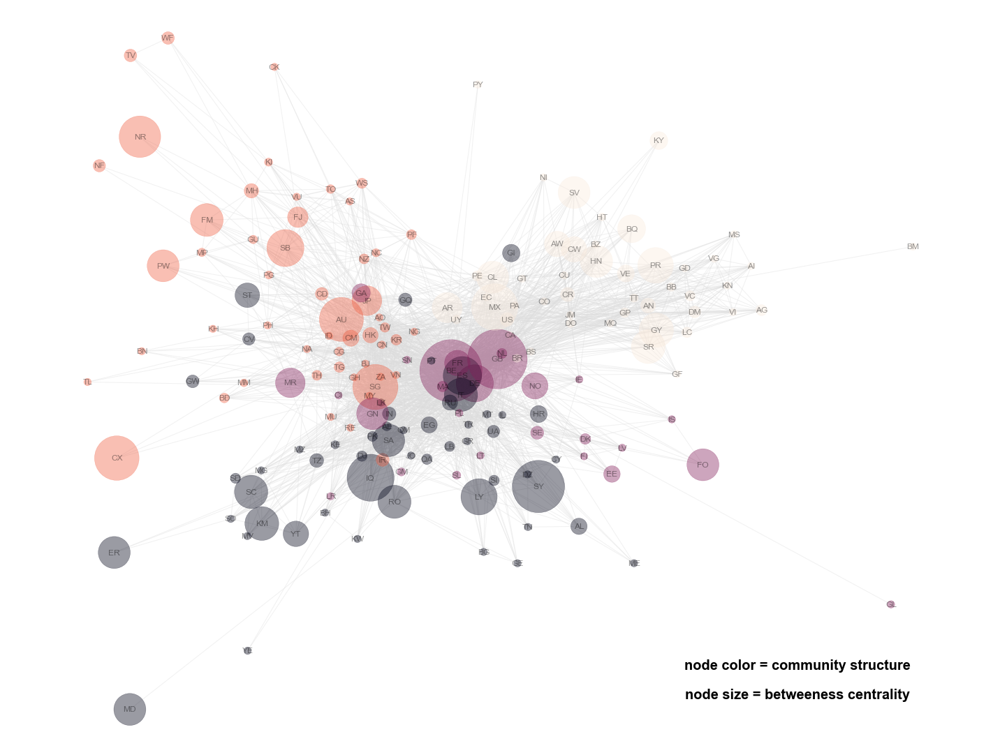

In [483]:

# compute centrality
centrality = nx.betweenness_centrality(G18, k=10, endpoints=True, weight='weight_sum')

lpc =community.best_partition(G, weight='weight_sum')

#### draw graph ####
fig, ax = plt.subplots(figsize=(20, 15))
pos = nx.spring_layout(G18, k=0.15, seed=4572321)
node_color = [lpc[n] for n in G18]
node_size = [v * 20000 for v in centrality.values()]
nx.draw_networkx(
    G18,
    pos=pos,
    with_labels=True,
    node_color=node_color,
    node_size=node_size,
    edge_color="gainsboro",
    alpha=0.4,
)

# Title/legend
font = {"color": "k", "fontweight": "bold", "fontsize": 20}
ax.set_title("", font)
# Change font color for legend
font["color"] = "k"

ax.text(
    0.80,
    0.10,
    "node color = community structure",
    horizontalalignment="center",
    transform=ax.transAxes,
    fontdict=font,
)
ax.text(
    0.80,
    0.06,
    "node size = betweeness centrality",
    horizontalalignment="center",
    transform=ax.transAxes,
    fontdict=font,
)

# Resize figure for label readibility
ax.margins(0.1, 0.05)
fig.tight_layout()
plt.axis("off")
plt.show()

In [ ]:
nx.read_gpickle(os.path.join("C:\\Users\\dauly\\Desktop\\mdst\\pickled","net_cntr_{}.gpickle".format(y)))


In [419]:
df2018  = external[external['year']==2018]

In [421]:
df2018 = df2018.groupby(['Port1_iso','Port2_iso'])['Quarterly deployed capacity (TEU)'].sum().reset_index()

In [424]:
df2018.columns = ['source','target','weight_sum']
G18 = nx.from_pandas_edgelist(df2018, source="source", target="target", 
                            edge_attr='weight_sum')
   
nx.set_node_attributes(G, values = cdict_inv, name='label')

In [427]:
rc = nx.rich_club_coefficient(G18, normalized=True, seed=42)

In [428]:
rc

{0: 1.0,
 1: 1.0,
 2: 1.0,
 3: 1.0,
 4: 1.0003780718336484,
 5: 1.0003795066413663,
 6: 1.00038037276531,
 7: 1.000383435582822,
 8: 1.0,
 9: 1.0007821666014862,
 10: 1.0011914217633042,
 11: 1.0024570024570023,
 12: 1.0059322033898306,
 13: 1.0065245759025663,
 14: 1.0066021126760565,
 15: 1.0067264573991033,
 16: 1.010275572162541,
 17: 1.0119388729703915,
 18: 1.0155189136760427,
 19: 1.0183579806221317,
 20: 1.020997375328084,
 21: 1.0264462809917356,
 22: 1.0360884749708965,
 23: 1.04798962386511,
 24: 1.058226134055518,
 25: 1.0604586518415566,
 26: 1.0643776824034334,
 27: 1.094090202177294,
 28: 1.0941271118262268,
 29: 1.0972104818258666,
 30: 1.0966875559534468,
 31: 1.101489757914339,
 32: 1.1051502145922745,
 33: 1.1225728155339807,
 34: 1.1209677419354838,
 35: 1.1374269005847955,
 36: 1.126365054602184,
 37: 1.126365054602184,
 38: 1.1552346570397112,
 39: 1.1551401869158877,
 40: 1.1551401869158877,
 41: 1.1585127201565557,
 42: 1.141280353200883,
 43: 1.141280353200883,

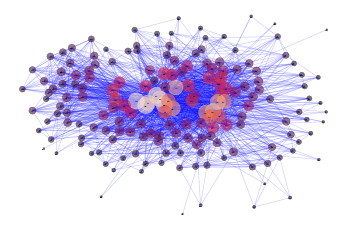

In [445]:

pos = nx.kamada_kawai_layout(G18)#, weight='weight_sum')
node_color = [float(G18.degree(v)) for v in G18]
nx.draw_networkx_nodes(G18, pos, node_size=[float(G18.degree(v)) * 2.5 for v in G18],
             alpha=0.6, node_color=node_color)
nx.draw_networkx_edges(G18, pos, alpha=0.25, edge_color='blue', width=0.5,
arrows=False)
nx.draw_networkx_labels(G18, pos, font_size=2.5)

plt.axis('off')
plt.show()

In [429]:
fig = plt.figure()
#fig = plt.figure(figsize=(8,8), dpi=1000) - pdf file
pos = nx.graphviz_layout(G18, prog='neato')
node_color = [float(G18.degree(v)) for v in G]
nx.draw_networkx_nodes(G18, pos, node_size=[float(G.degree(v)) * 2.5 for v in G18],
             alpha=0.6, node_color=node_color)
nx.draw_networkx_edges(G18, pos, alpha=0.25, edge_color='blue', width=0.5,
arrows=False)
nx.draw_networkx_labels(G18, pos, font_size=2.5)

plt.axis('off')
plt.show()
#plt.savefig("directedGraph.pdf")

AttributeError: module 'networkx' has no attribute 'graphviz_layout'

<Figure size 432x288 with 0 Axes>

In [455]:
centals = pd.concat(frames_list)
centals['country'] = centals['index'].map(cdict)
centals.to_csv("Centralities.csv")

In [333]:
output.dtypes

No_edges                      int64
No_nodes                      int64
Avg_degree                  float64
Clustering_coef             float64
Avg_shortest_path_length    float64
Radius                        int64
Diameter                      int64
eccentricity                float64
center                       object
periphery                    object
density                     float64
Global efficiency           float64
dtype: object

In [346]:
sns.set_style("ticks")

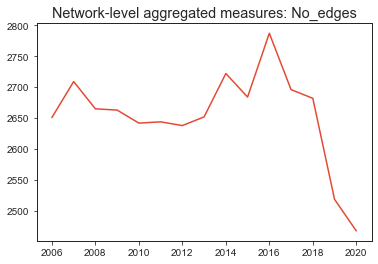

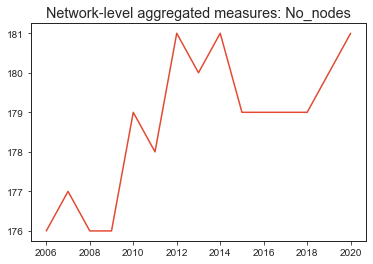

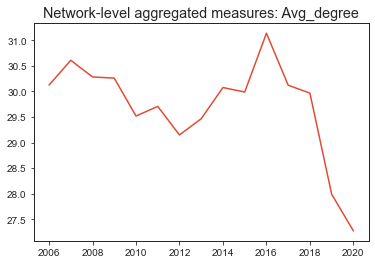

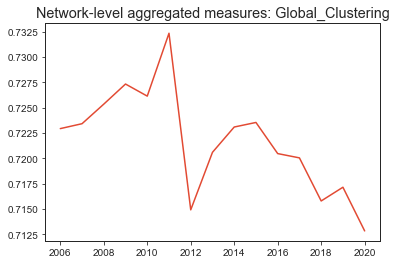

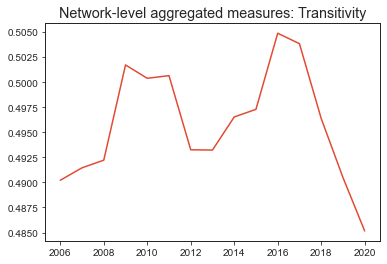

...

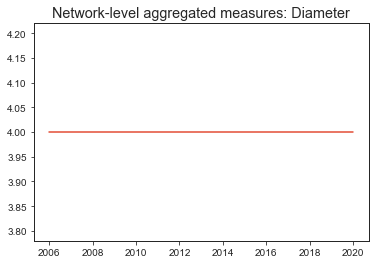

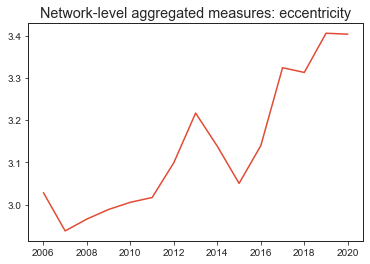

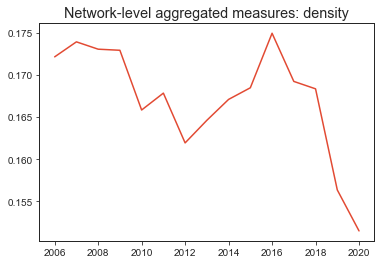

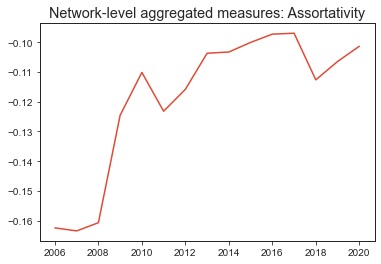

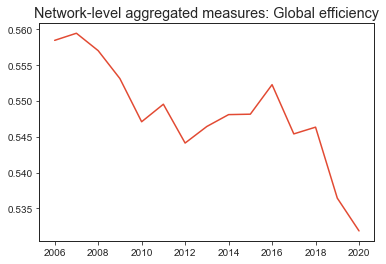

In [458]:
output = pd.DataFrame.from_dict(gdict, orient='index')
for o in list(output.columns):
    if o !='center' and o!='periphery':
        try:
            fig, ax = plt.subplots()
            output[o].plot(ax=ax)
            plt.title("Network-level aggregated measures: {}".format(o))
            plt.show()
            fig.savefig("net_measure_ts_{}".format(o))
        except TypeError:
            pass
output.to_csv("output_network_country.csv")
    

In [325]:
sorted(nx.center(G),reverse=True)

['SG', 'KR', 'CN']

In [319]:
combo = combo.rename(columns={ 'Quarterly deployed capacity (TEU)':"int_flows_capacity",'cap_sum':"ext_flow_capacity"})

In [320]:
combo

,iso2,ext_flow_capacity,year,Port1_iso,int_flows_capacity,_merge
0,AE,9.001243e+07,2006,AE,7.297071e+06,both
1,AO,6.048443e+06,2006,AO,9.785529e+05,both
2,AR,4.179740e+07,2006,AR,2.418892e+06,both
3,BE,1.397990e+08,2006,NaN,NaN,left_only
4,BH,2.398556e+06,2006,NaN,NaN,left_only
...,...,...,...,...,...,...
2676,TV,4.038900e+04,2020,NaN,NaN,left_only
2677,WF,2.912100e+04,2020,NaN,NaN,left_only
2678,MV,1.182148e+06,2020,NaN,NaN,left_only
2679,MD,7.800000e+03,2020,NaN,NaN,left_only


In [321]:
combo = combo.drop(columns=['Port1_iso','_merge'])
combo['int_flows_capacity'] = combo['int_flows_capacity'].fillna(0)

In [ ]:
combo['cap_sum'] = combo['ext_flow_capacity']+combo['int_flows_capacity']
combo['int_ratio'] = combo['ext_flow_capacity']/combo['sum']
combo['ext_ratio'] = combo['ext_flow_capacity']/combo['sum']

In [322]:
combo.to_csv("combo_flows_df.csv")

In [449]:
import glob
files = glob.glob("C:\\Users\\dauly\\Desktop\\mdst\\pickled\\*.gpickle")
for f in files:
    naming = f.split("\\")[-1]
    years = naming.split(".")[0][-4:]
    print(years)
    G = nx.read_gpickle(f)
    attr_dict = nx.get_node_attributes(G,'weight')
    print(attr_dict)
    break
    pos = nx.spring_layout(G)
    betCent = nx.betweenness_centrality(G, weight='weight_sum',normalized=True, endpoints=True)
    node_color = [20000.0 * G.degree(v) for v in G]
    node_size =  [v * 10000 for v in betCent.values()]
    fig = plt.figure(figsize=(20,20))
    nx.draw_networkx(G, pos=pos, with_labels=True,
                 node_color=node_color,
                 node_size=node_size )
    plt.title("{}: normalized betweenness centrality".format(years))
    plt.axis('off');
    fig.savefig("y{}_betw_centr.png".format(years))
    print(years, sorted(betCent, key=betCent.get, reverse=True)[:5])

2006
{}


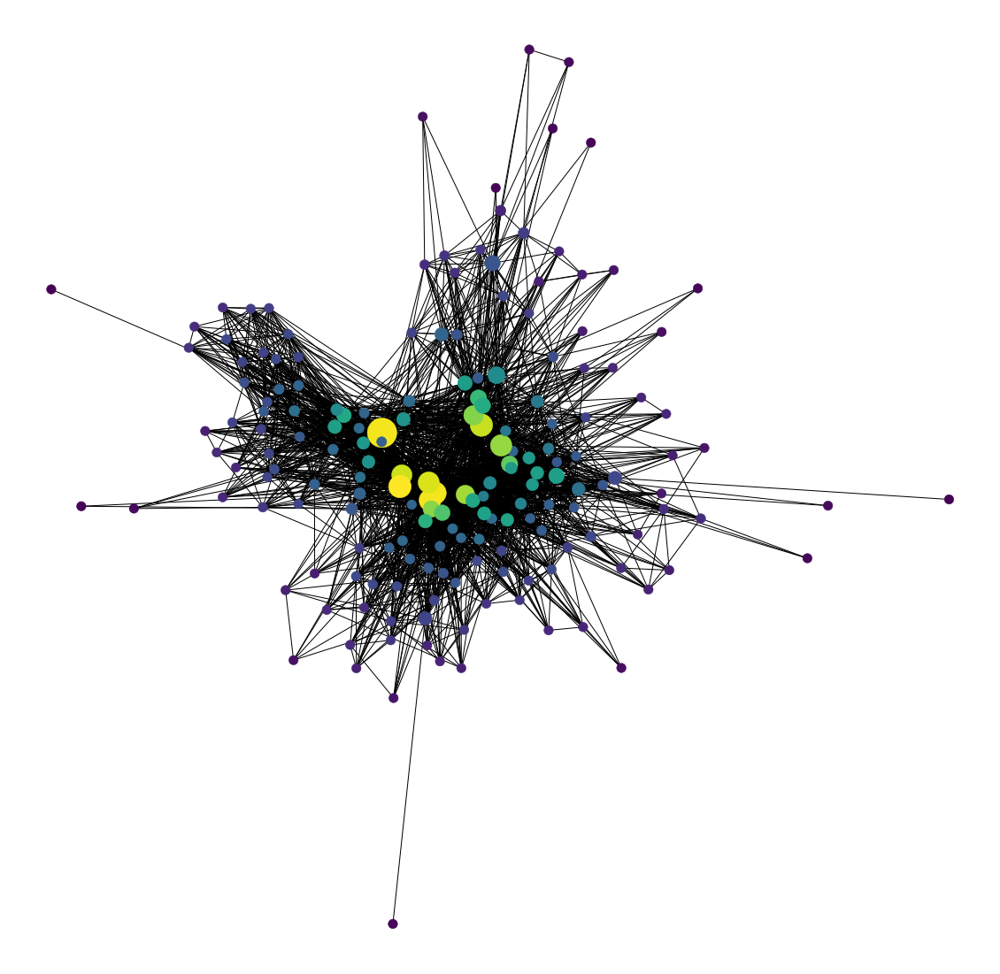

In [213]:
pos = nx.spring_layout(G)
betCent = nx.betweenness_centrality(G, normalized=True, endpoints=True)
node_color = [20000.0 * G.degree(v) for v in G]
node_size =  [v * 10000 for v in betCent.values()]
plt.figure(figsize=(20,20))
nx.draw_networkx(G, pos=pos, with_labels=False,
                 node_color=node_color,
                 node_size=node_size )
plt.axis('off');

In [214]:
sorted(betCent, key=betCent.get, reverse=True)[:5]

['US', 'GB', 'CN', 'BE', 'ES']

2006 :  ['GB', 'BE', 'ES', 'FR', 'DE']
2007 :  ['BE', 'GB', 'FR', 'ES', 'DE']


KeyboardInterrupt: 

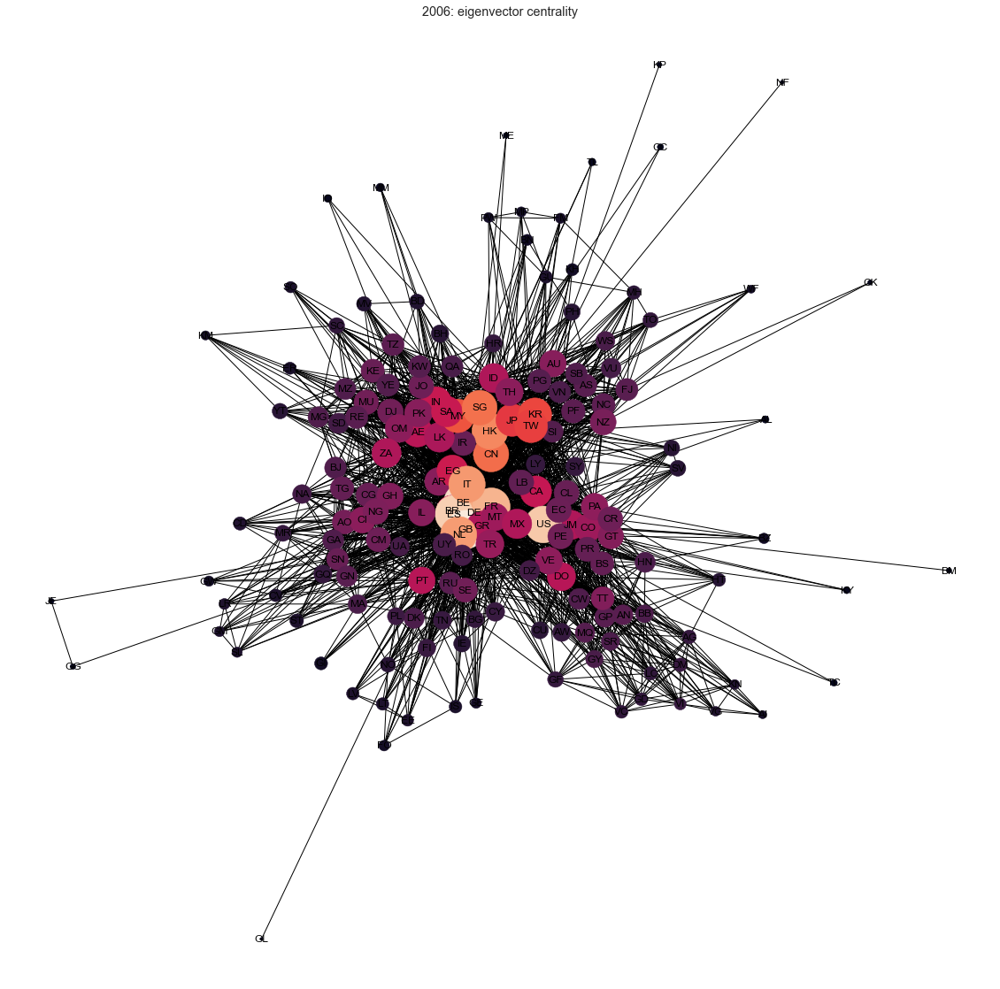

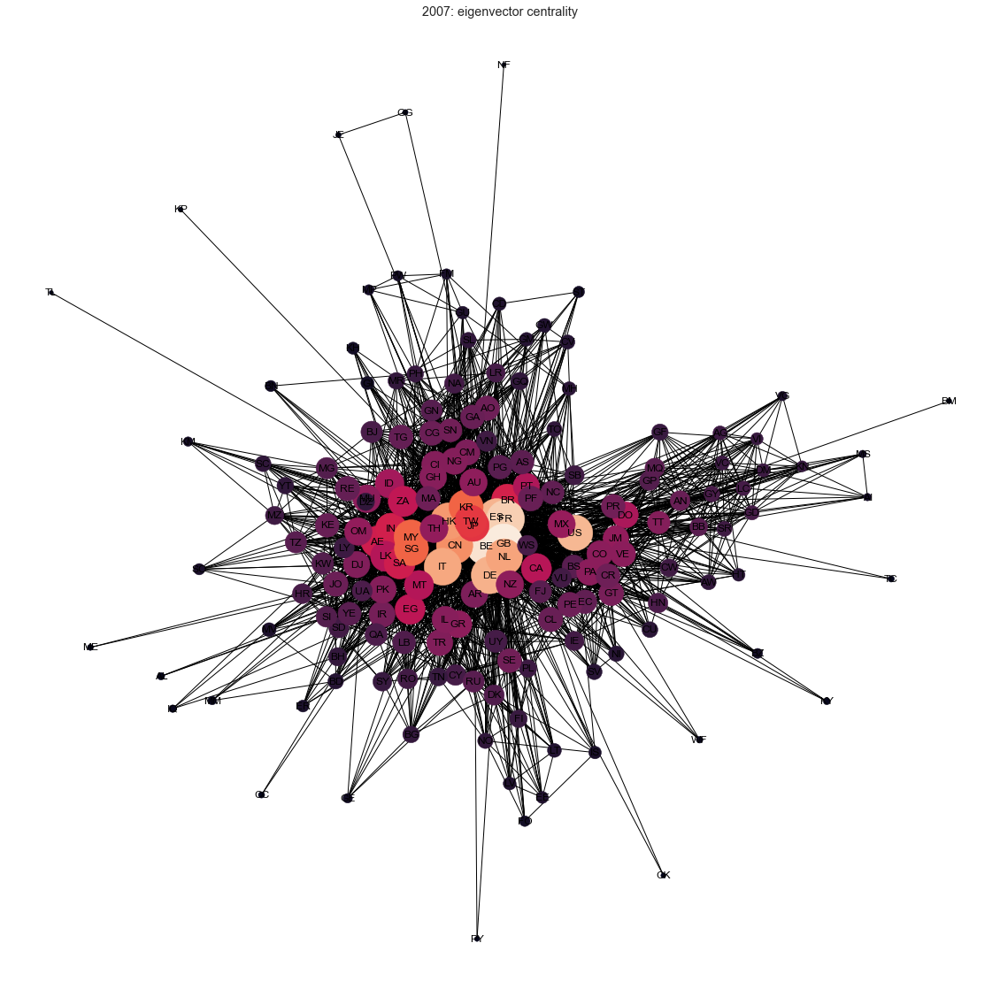

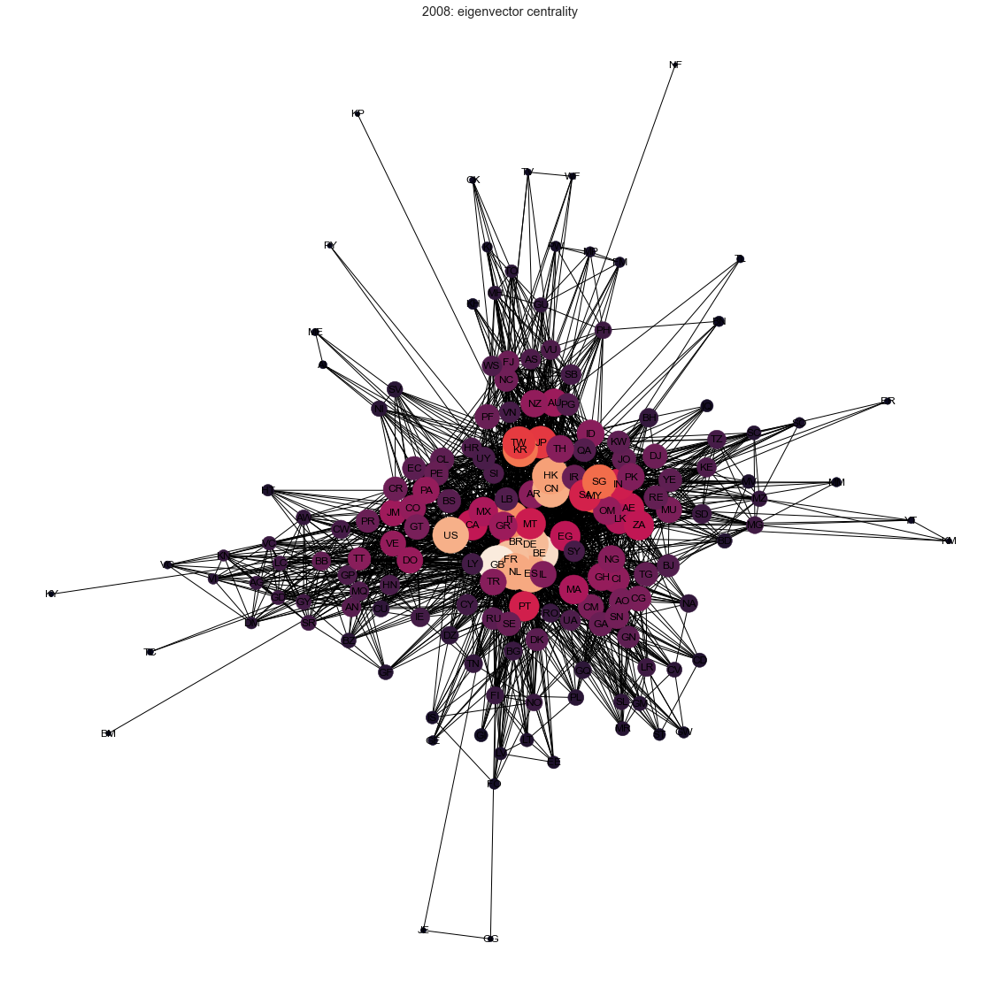

In [368]:
import glob
files = glob.glob("C:\\Users\\dauly\\Desktop\\mdst\\pickled\\*.gpickle")
for f in files:
    naming = f.split("\\")[-1]
    years = naming.split(".")[0][-4:]
    G = nx.read_gpickle(f)
    pos = nx.spring_layout(G)
    ecent = nx.eigenvector_centrality(G)
    node_color = [20000.0 * G.degree(v) for v in G]
    node_size =  [v * 10000 for v in ecent.values()]
    fig = plt.figure(figsize=(20,20))
    nx.draw_networkx(G, pos=pos, with_labels=True,
                 node_color=node_color,
                 node_size=node_size )
    plt.title("{}: eigenvector centrality".format(years))
    plt.axis('off');
    fig.savefig("y{}_ecent_centr.png".format(years))
    print(years,": ", sorted(ecent, key=ecent.get, reverse=True)[:5])

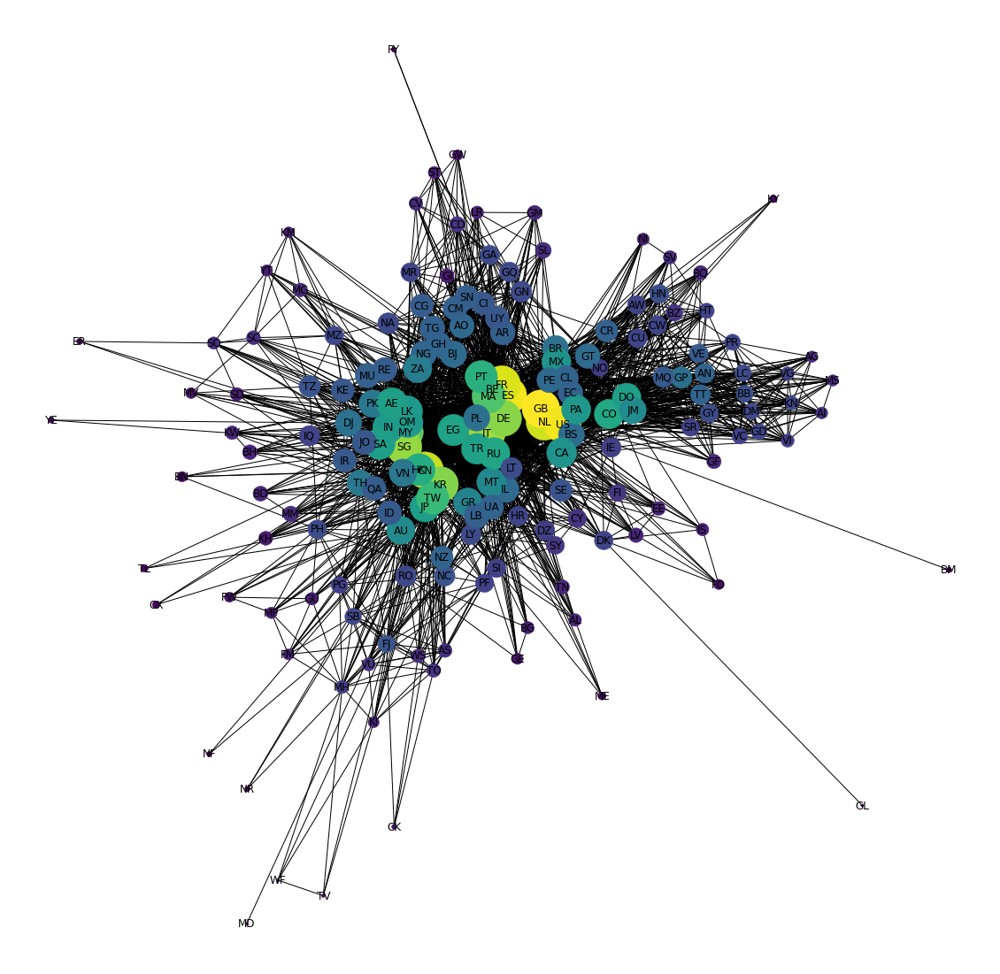

In [222]:
pos = nx.spring_layout(G)
ecent = nx.eigenvector_centrality(G)
node_color = [20000.0 * G.degree(v) for v in G]
node_size =  [v * 10000 for v in ecent.values()]
plt.figure(figsize=(20,20))
nx.draw_networkx(G, pos=pos, with_labels=True,
                 node_color=node_color,
                 node_size=node_size )
plt.axis('off');

In [216]:
sorted(ecent, key=ecent.get, reverse=True)[:5]

['BE', 'ES', 'GB', 'FR', 'NL']

2006
2006 ['GB', 'BE', 'ES', 'US', 'FR']
2007
2007 ['GB', 'BE', 'FR', 'US', 'ES']
2008
2008 ['GB', 'BE', 'FR', 'DE', 'US']
2009
2009 ['GB', 'BE', 'NL', 'US', 'FR']
2010
2010 ['GB', 'BE', 'US', 'NL', 'FR']
2011
2011 ['GB', 'BE', 'US', 'FR', 'NL']
2012
2012 ['US', 'BE', 'GB', 'FR', 'ES']
2013
2013 ['US', 'GB', 'FR', 'BE', 'ES']
2014
2014 ['US', 'GB', 'FR', 'BE', 'ES']
2015
2015 ['BE', 'US', 'GB', 'ES', 'FR']
2016
2016 ['US', 'BE', 'GB', 'ES', 'FR']
2017
2017 ['US', 'BE', 'GB', 'CN', 'ES']
2018
2018 ['GB', 'US', 'BE', 'ES', 'CN']
2019
2019 ['US', 'ES', 'BE', 'GB', 'CN']
2020
2020 ['US', 'CN', 'GB', 'BE', 'NL']


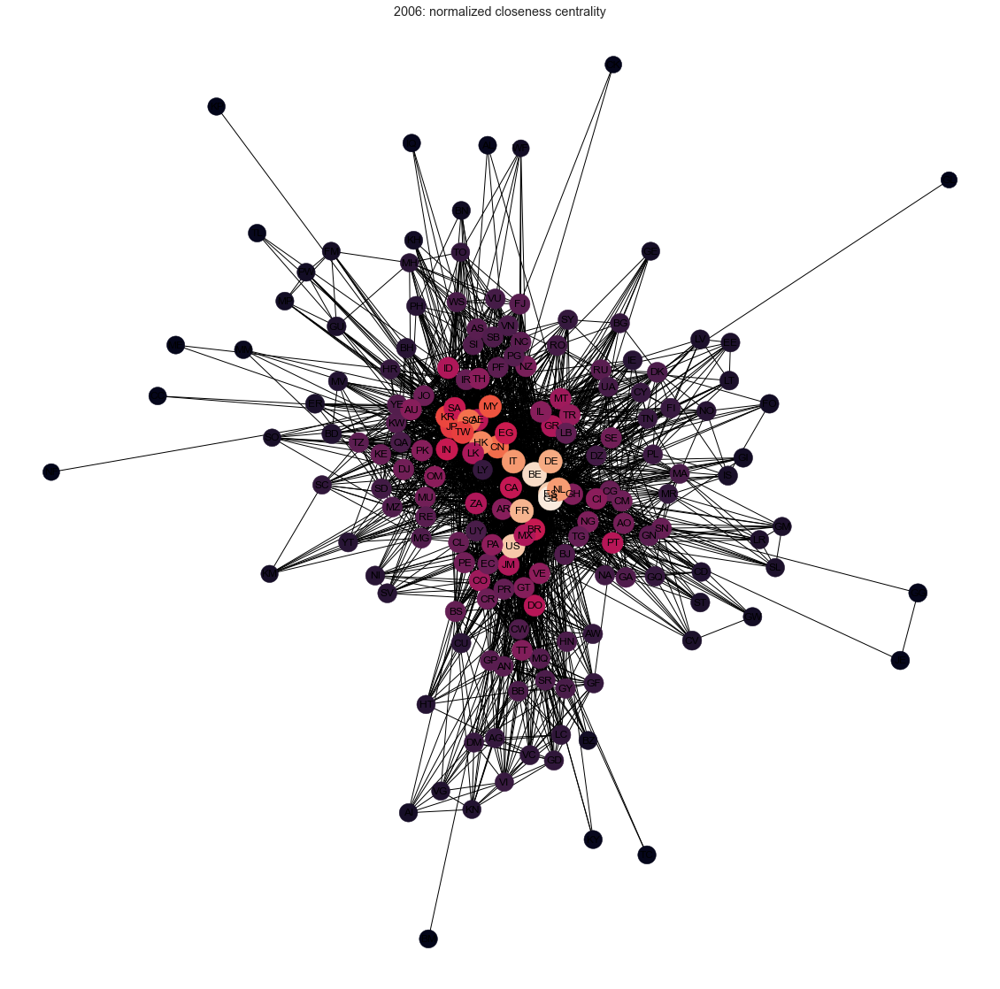

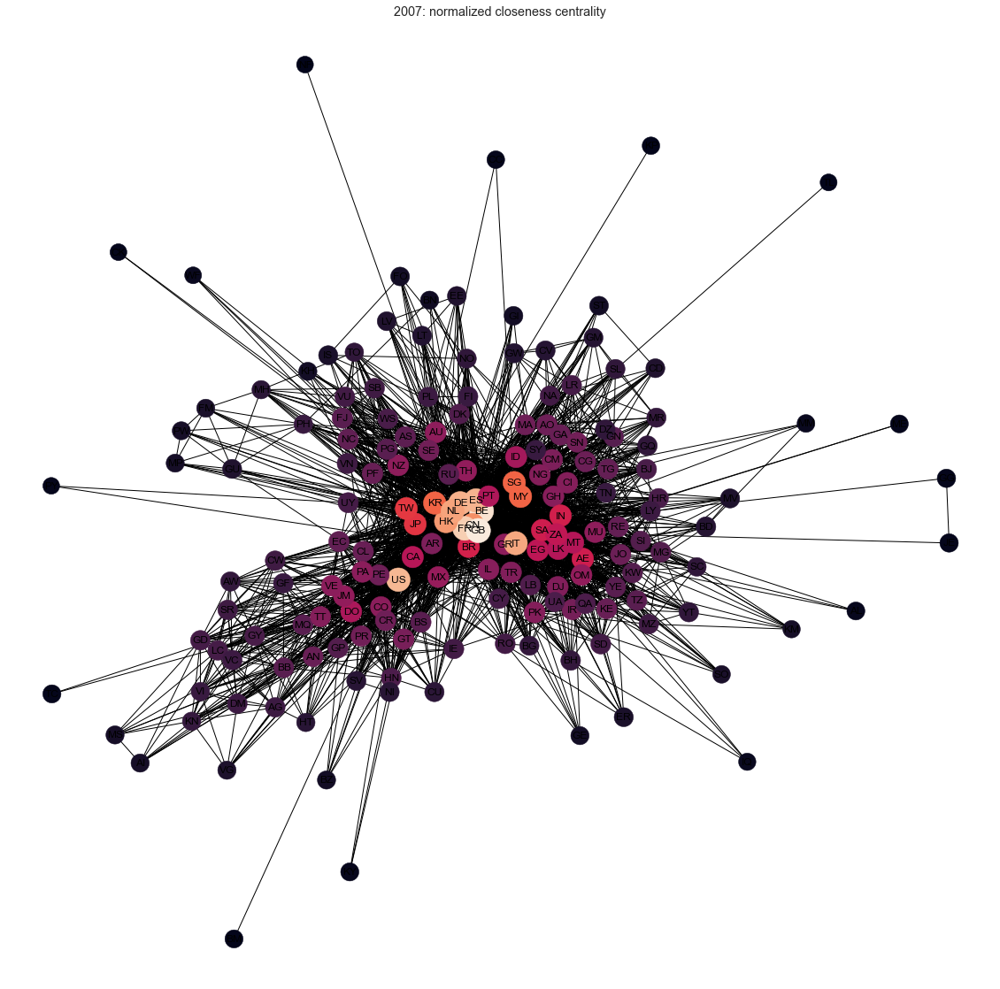

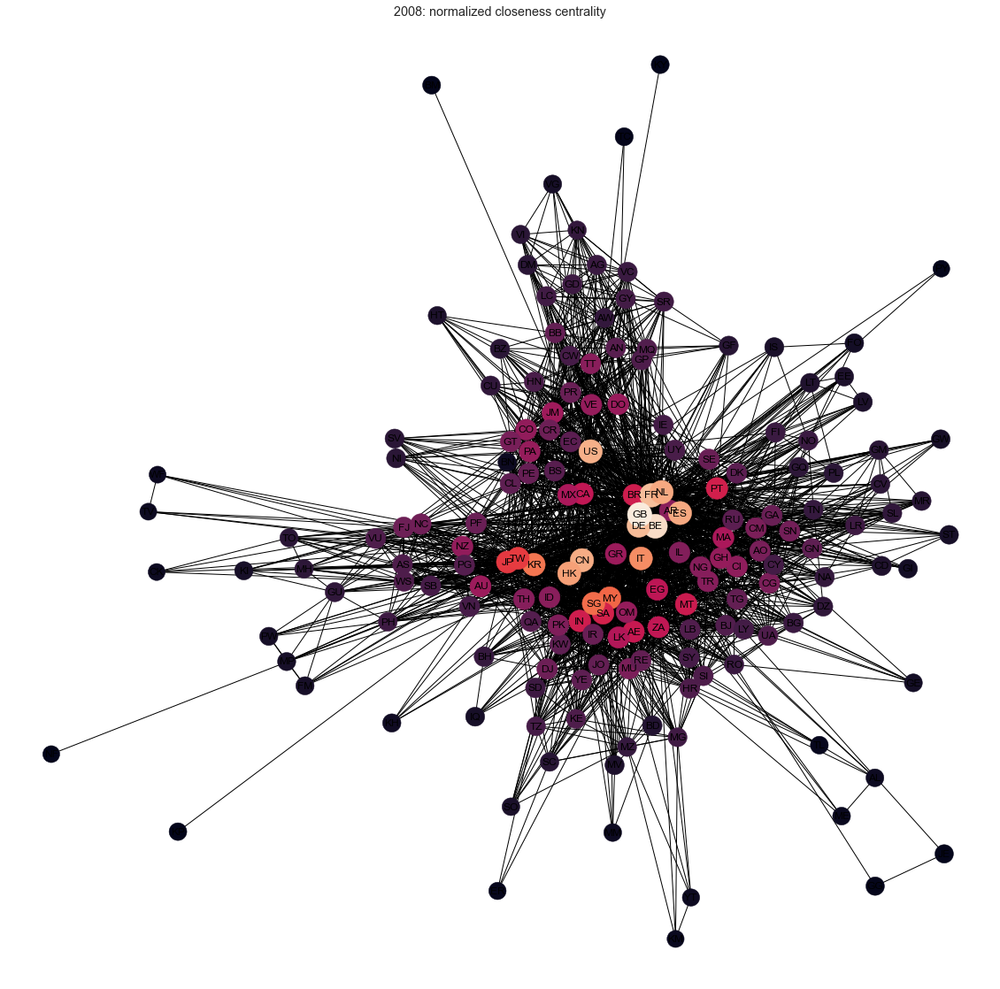

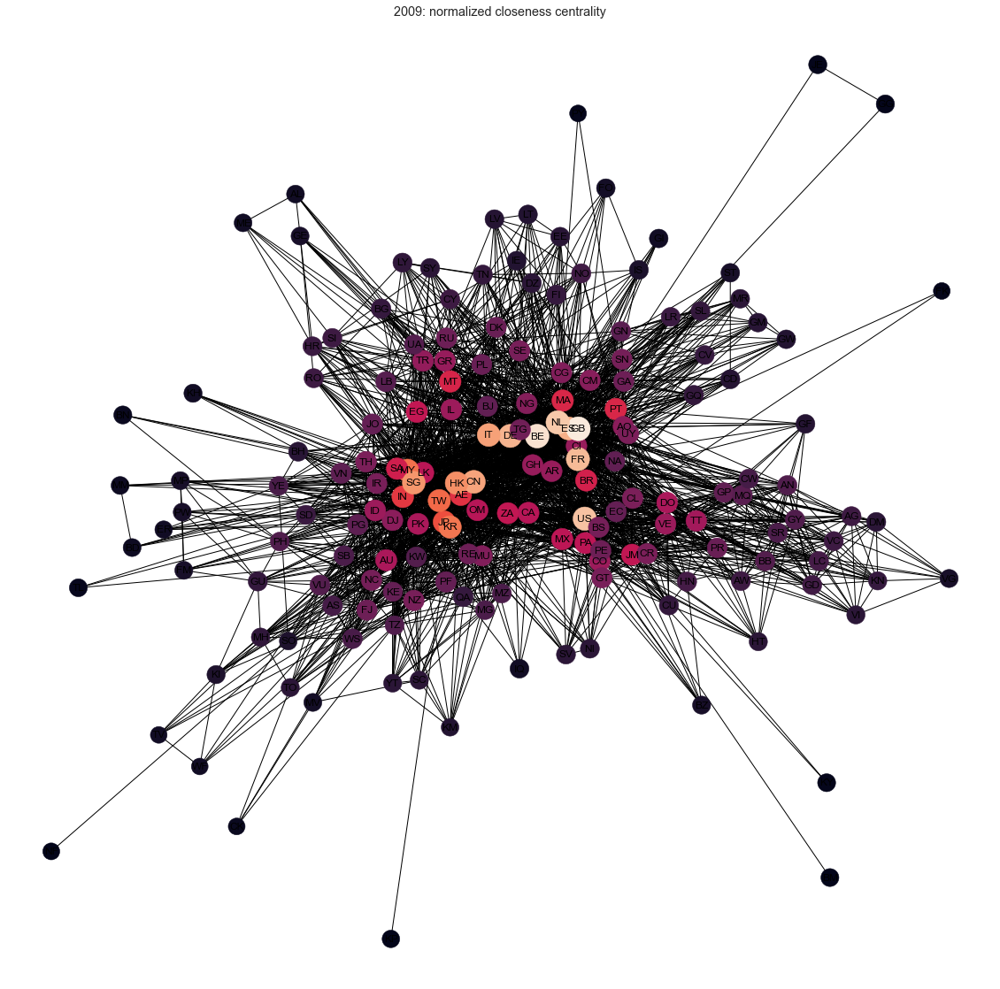

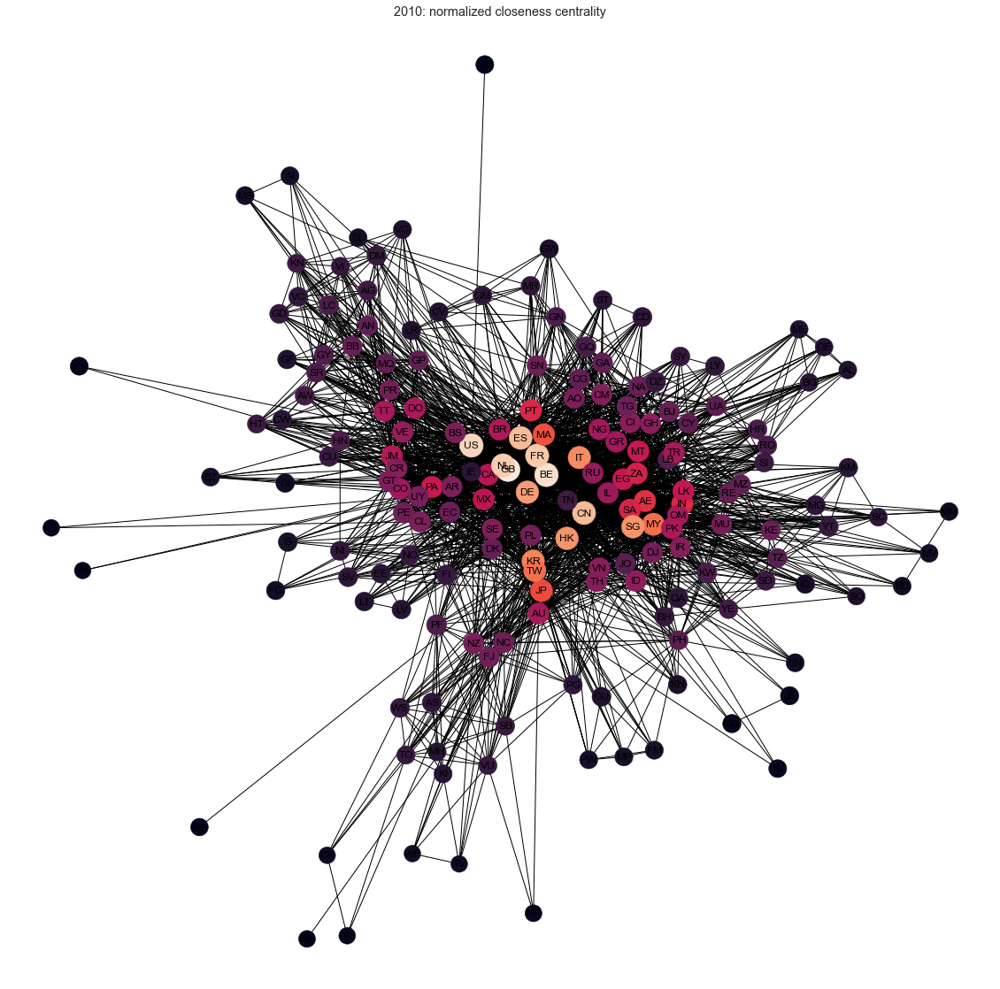

...

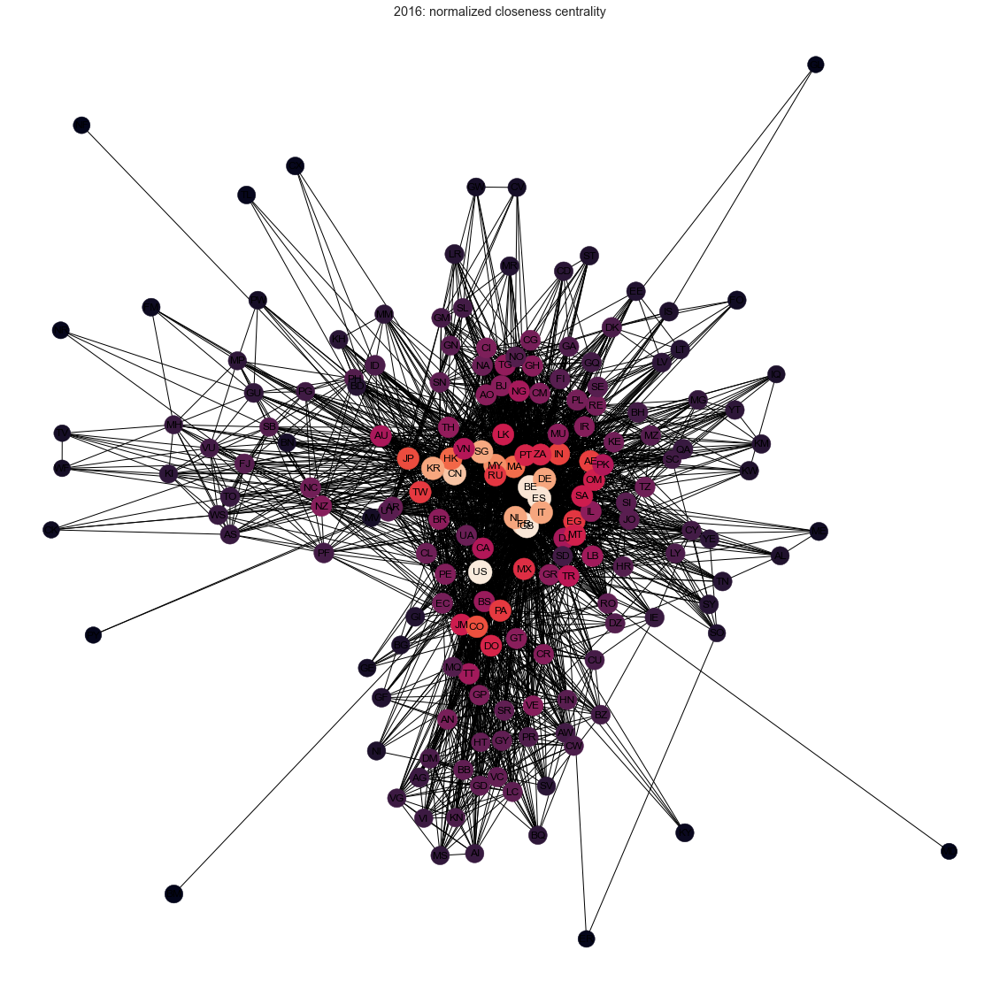

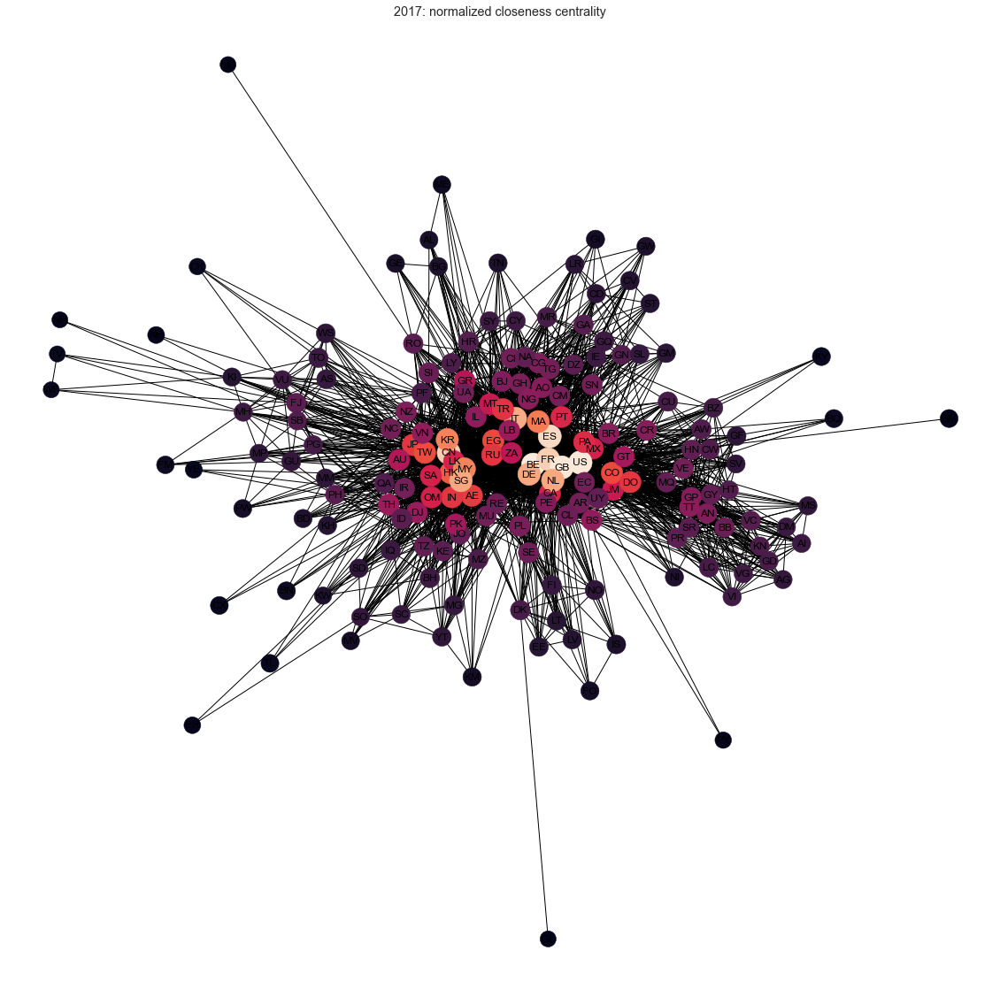

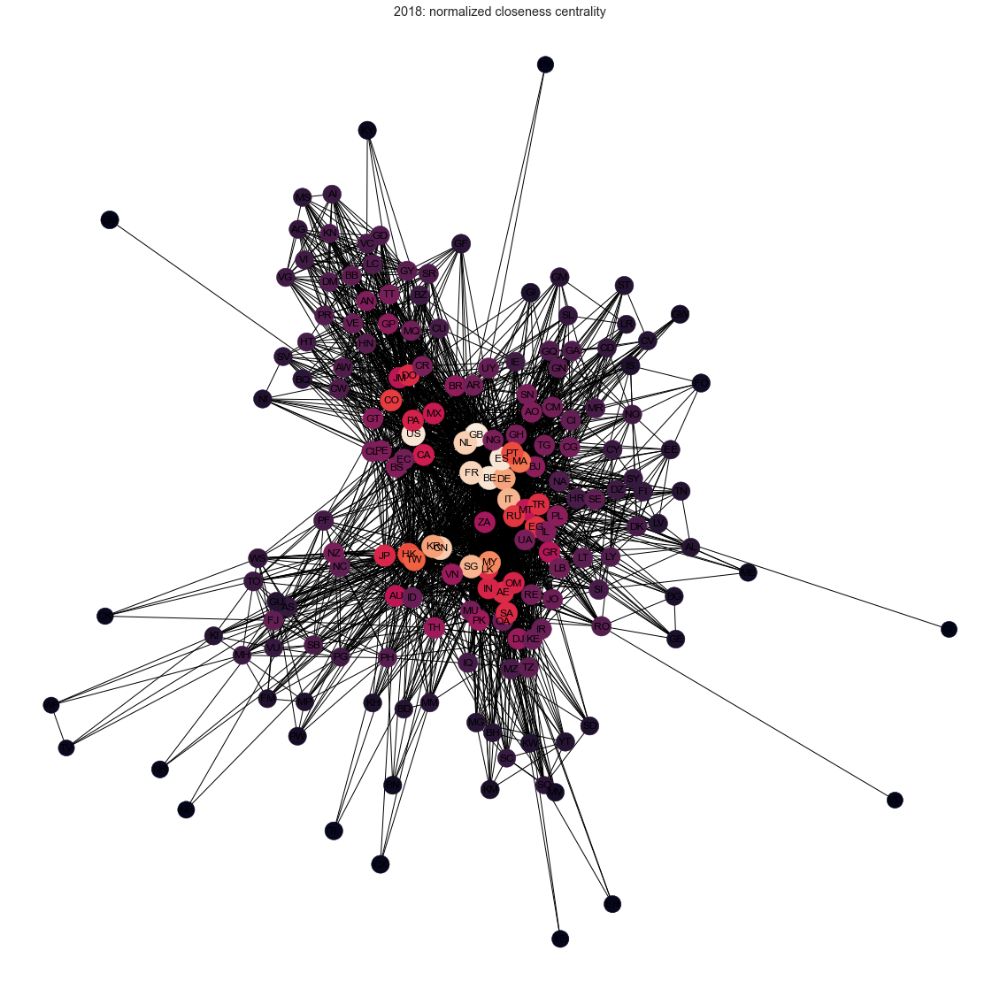

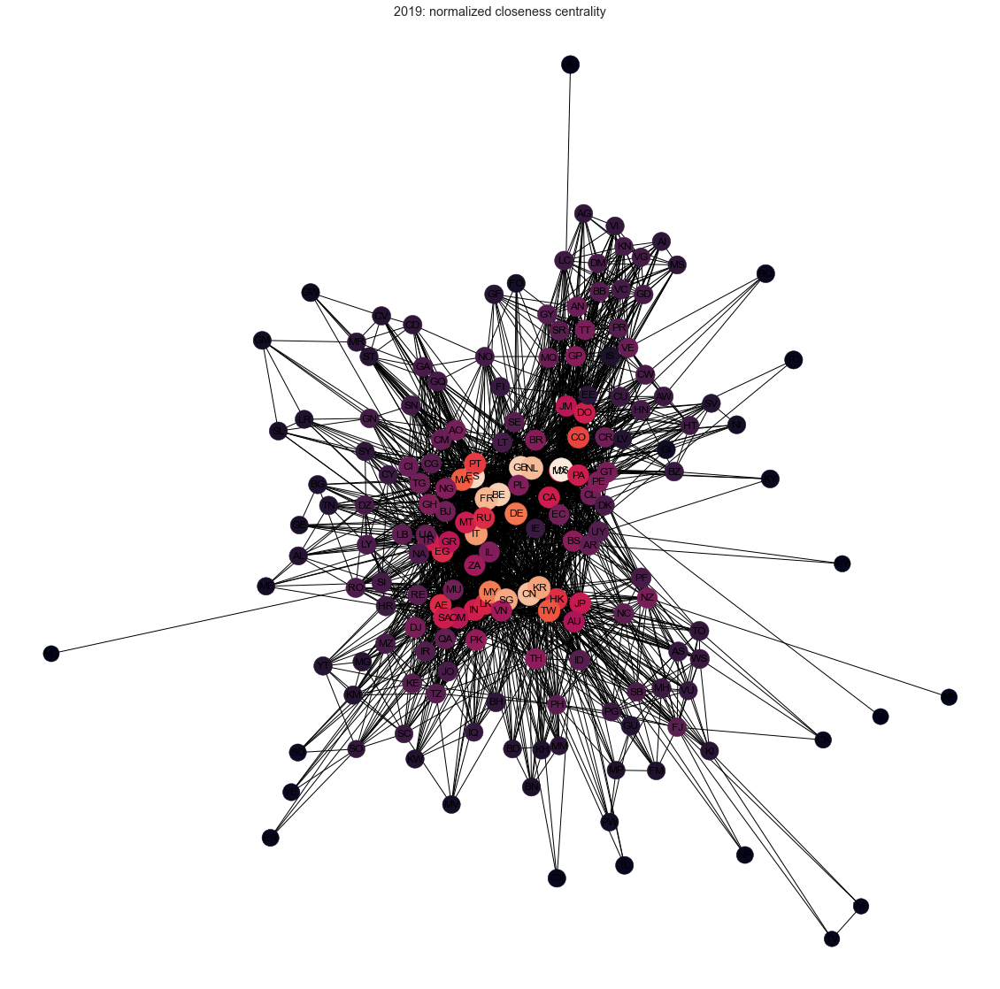

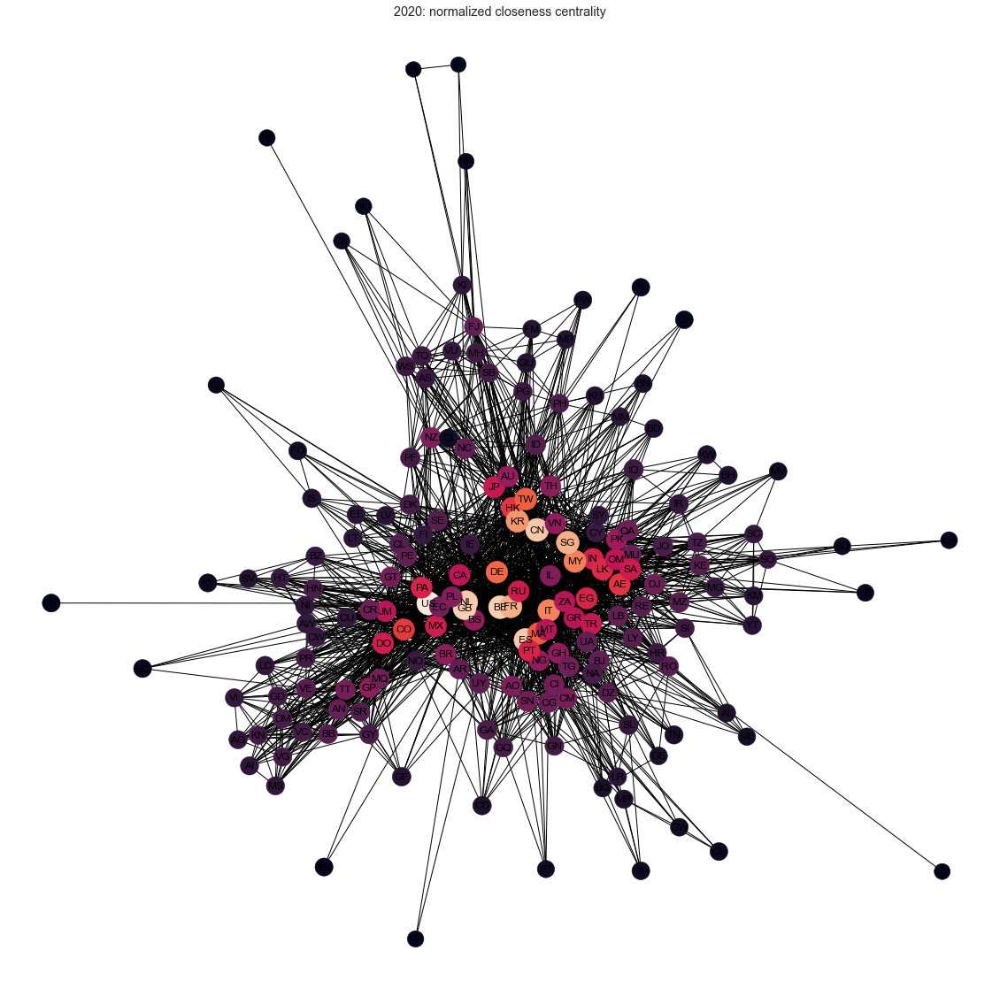

In [366]:
import glob
files = glob.glob("C:\\Users\\dauly\\Desktop\\mdst\\pickled\\*.gpickle")
for f in files:
    naming = f.split("\\")[-1]
    years = naming.split(".")[0][-4:]
    print(years)
    G = nx.read_gpickle(f)
    pos = nx.spring_layout(G)
    ccent = nx.closeness_centrality(G)
    node_color = [20000.0 * G.degree(v) for v in G]
    node_size =  [v * 1000 for v in ccent.values()]
    fig = plt.figure(figsize=(20,20))
    nx.draw_networkx(G, pos=pos, with_labels=True,
                 node_color=node_color,
                 node_size=node_size )
    plt.title("{}: normalized closeness centrality".format(years))
    plt.axis('off');
    fig.savefig("y{}_close_centr.png".format(years))
    print(years, sorted(ccent, key=ccent.get, reverse=True)[:5])

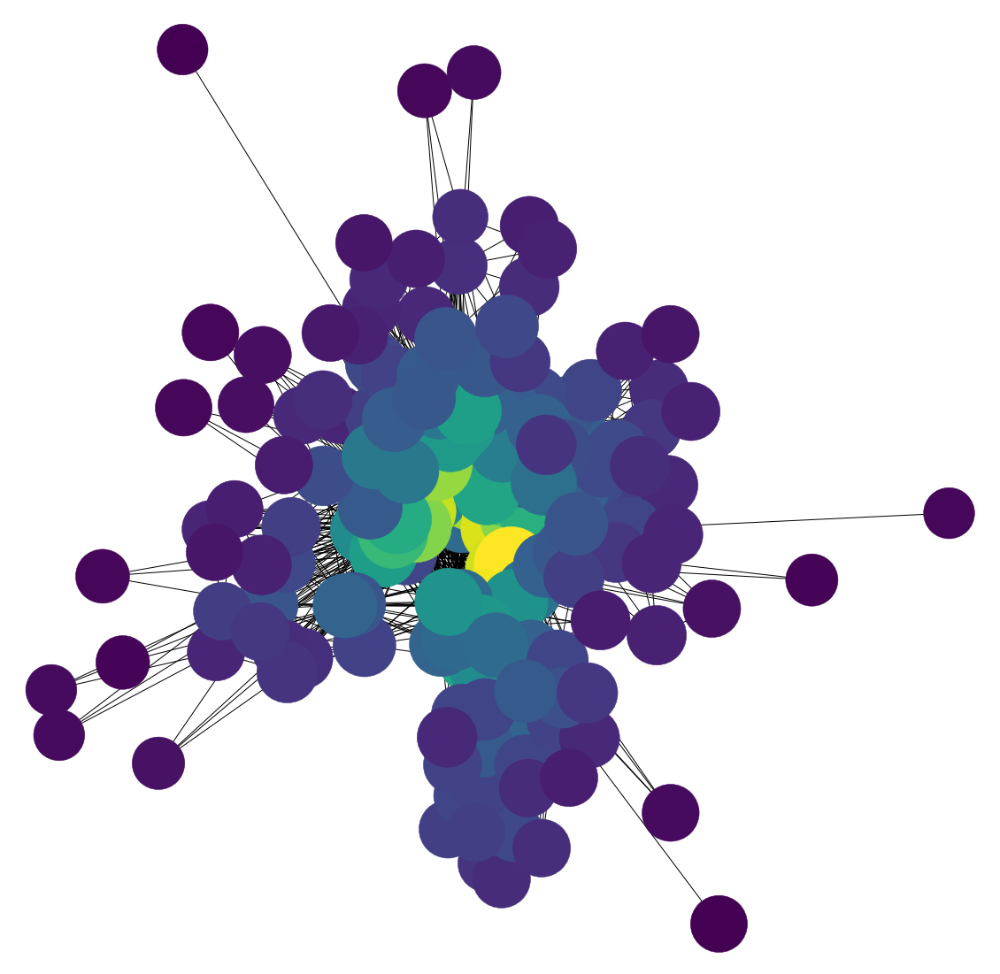

In [217]:
pos = nx.spring_layout(G)
ccent = nx.closeness_centrality(G)
node_color = [20000.0 * G.degree(v) for v in G]
node_size =  [v * 10000 for v in ccent.values()]
plt.figure(figsize=(20,20))
nx.draw_networkx(G, pos=pos, with_labels=False,
                 node_color=node_color,
                 node_size=node_size )
plt.axis('off');

In [219]:
sorted(ccent, key=ccent.get, reverse=True)[:5]

['GB', 'US', 'BE', 'ES', 'CN']

In [220]:
nx.average_clustering(G)

0.7157815297313441

In [ ]:
dfedges = pd.read_csv(".csv", sep = ",")
dfedges = dfedges[['is ource', 'target', 'weight']]
tuples = [tuple(x) for x in dfedges.values]

G=nx.Graph() 
G.add_weighted_edges_from(tuples)

In [221]:
G.edges(data=True)

EdgeDataView([('AL', 'DZ', {'weight_sum': 11736.0, 'weight_mean': 5868.0, 'weight_count': 2}), ('AL', 'HR', {'weight_sum': 43849.0, 'weight_mean': 21924.5, 'weight_count': 2}), ('AL', 'GR', {'weight_sum': 11736.0, 'weight_mean': 5868.0, 'weight_count': 2}), ('AL', 'IL', {'weight_sum': 59592.0, 'weight_mean': 14898.0, 'weight_count': 4}), ('AL', 'IT', {'weight_sum': 199335.5, 'weight_mean': 14238.25, 'weight_count': 14}), ('AL', 'LY', {'weight_sum': 11736.0, 'weight_mean': 5868.0, 'weight_count': 2}), ('AL', 'MT', {'weight_sum': 43777.5, 'weight_mean': 14592.5, 'weight_count': 3}), ('AL', 'ME', {'weight_sum': 49055.5, 'weight_mean': 16351.833333333334, 'weight_count': 3}), ('AL', 'SI', {'weight_sum': 29796.0, 'weight_mean': 14898.0, 'weight_count': 2}), ('AL', 'ES', {'weight_sum': 23472.0, 'weight_mean': 5868.0, 'weight_count': 4}), ('AL', 'TN', {'weight_sum': 23472.0, 'weight_mean': 5868.0, 'weight_count': 4}), ('AL', 'TR', {'weight_sum': 35208.0, 'weight_mean': 5868.0, 'weight_count':

In [135]:
df_edges = frame.copy()

In [184]:
meta[['CountryCode','CountryArea']].to_csv("country_codes_export.csv")

In [ ]:
# Calculate eigenvector centrality of matrix G 
# with the exports value as weights
ec = nx.eigenvector_centrality_numpy(G, weight='weight')

# Set this as a node attribute for each node
nx.set_node_attributes(G, 'cent', ec)

# Use this measure to determine the node color in viz
node_color = [float(G.node[v]['cent']) for v in G]

In [145]:
nodedata.head()

,id,CountryCode
0,AEAJM,AE
84,AEAUH,AE
462,AEDXB,AE
995,AEFJR,AE
1131,AEJEA,AE


In [76]:
nx.average_clustering(g)

0.671650438473021

In [154]:
nx.average_clustering(G)

0.6770506430034573

In [ ]:
# Visualization
# Calculate position of each node in G using networkx spring layout
pos = nx.spring_layout(G,k=30,iterations=8) 

# Draw nodes
nodes = nx.draw_networkx_nodes(G,pos, node_size=node_size, \
                               node_color=node_color, alpha=0.5) 
# Draw edges
edges = nx.draw_networkx_edges(G, pos, edge_color='lightgray', \
                               arrows=False, width=0.05,)

# Add labels
nx.draw_networkx_labels(G,pos,font_size=5)
nodes.set_edgecolor('gray')

# Add labels and title
plt.text(0,-0.1, \
         'Node color is eigenvector centrality; \
         Node size is value of global exports', \
         fontsize=7)
plt.title('Scrap Aluminum trade network, 2012', fontsize=12)

# Bar with color scale for eigenvalues
cbar = plt.colorbar(mappable=nodes, cax=None, ax=None, fraction=0.015, pad=0.04)
cbar.set_clim(0, 1)

# Plot options
plt.margins(0,0)
plt.axis('off')

# Save as high quality png
plt.savefig('760200.png', dpi=1000)

### Identfy Russian ports and their network of radius = 1

In [ ]:
hub_ego = nx.ego_graph(graph, node)
pos = nx.spring_layout(hub_ego)
nx.draw(hub_ego, pos, node_color='b', node_size=900)
nx.draw_networkx_nodes(hub_ego, pos, nodelist=[node], node_size=600, node_color='r')
plt.show()

In [196]:
(frame['Port1'].str.startswith("RU")).sum()

3434

In [206]:
idx = np.where((frame['Port1'].str.startswith("RU")) | (frame['Port2'].str.startswith("RU")))
rus = frame.loc[idx]

,Port1,Port2,year,No of services mean,Average annual frequency mean,Average number of ships mean,No of operators mean,No of Alliances mean,Average ship size (TEU) mean,Average ship age (months) mean,...,CountryArea_port2,MaritimeRegion_port2,PortSeaArea(Meda)_port2,Region(Meda)_port2,LatitudeDeg_port2,LongitudeDeg_port2,LatitudeDec_port2,LongitudeDec_port2,Tranship_port2,TSREgions_port2
2873,AEJEA,RUNVS,2013,1.0,52.0,6.00,1.000000,0.0,4486.000000,172.714286,...,Russia,Mediterranean,Black Sea,NaN,44°44'N,37°47'E,44.73,37.78,NaN,NaN
2874,AEJEA,RUNVS,2014,1.0,52.0,7.75,1.000000,0.0,4933.401786,158.107143,...,Russia,Mediterranean,Black Sea,NaN,44°44'N,37°47'E,44.73,37.78,NaN,NaN
2875,AEJEA,RUNVS,2015,1.0,52.0,8.00,1.000000,0.0,5416.843750,92.218750,...,Russia,Mediterranean,Black Sea,NaN,44°44'N,37°47'E,44.73,37.78,NaN,NaN
2876,AEJEA,RUNVS,2016,1.0,52.0,8.00,1.000000,0.0,5569.375000,35.593750,...,Russia,Mediterranean,Black Sea,NaN,44°44'N,37°47'E,44.73,37.78,NaN,NaN
2877,AEJEA,RUNVS,2017,1.0,52.0,7.75,1.000000,0.0,6362.758929,167.183036,...,Russia,Mediterranean,Black Sea,NaN,44°44'N,37°47'E,44.73,37.78,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
448898,ZADUR,RUVYP,2015,1.0,52.0,21.00,1.250000,0.0,8034.915584,105.626569,...,Russia,North Asia,China Sea,NaN,42°45'N,133°4'E,42.75,133.07,NaN,NaN
448899,ZADUR,RUVYP,2016,1.0,52.0,21.00,1.000000,0.0,8579.738095,172.928571,...,Russia,North Asia,China Sea,NaN,42°45'N,133°4'E,42.75,133.07,NaN,NaN
449840,ZAPLZ,RUVYP,2014,1.0,52.0,21.00,1.666667,0.0,6787.634033,82.414286,...,Russia,North Asia,China Sea,NaN,42°45'N,133°4'E,42.75,133.07,NaN,NaN
449841,ZAPLZ,RUVYP,2015,1.0,52.0,21.00,1.250000,0.0,8034.915584,105.626569,...,Russia,North Asia,China Sea,NaN,42°45'N,133°4'E,42.75,133.07,NaN,NaN


In [207]:
id1 = np.where(frame['Port1'].str.startswith("RU"))
id2 = np.where(frame['Port2'].str.startswith("RU"))
ru1 = frame.loc[id1]
ru2 = frame.loc[id2]

In [217]:
ru = ru1.sort_values(by=['Port2','year'])

In [216]:
#ru = ru2.sort_values(by=['Port1','year'])

,Port1,Port2,year,No of services mean,Average annual frequency mean,Average number of ships mean,No of operators mean,No of Alliances mean,Average ship size (TEU) mean,Average ship age (months) mean,...,CountryArea_port2,MaritimeRegion_port2,PortSeaArea(Meda)_port2,Region(Meda)_port2,LatitudeDeg_port2,LongitudeDeg_port2,LatitudeDec_port2,LongitudeDec_port2,Tranship_port2,TSREgions_port2
2873,AEJEA,RUNVS,2013,1.0,52.0,6.00,1.000000,0.0,4486.000000,172.714286,...,Russia,Mediterranean,Black Sea,NaN,44°44'N,37°47'E,44.73,37.78,NaN,NaN
2874,AEJEA,RUNVS,2014,1.0,52.0,7.75,1.000000,0.0,4933.401786,158.107143,...,Russia,Mediterranean,Black Sea,NaN,44°44'N,37°47'E,44.73,37.78,NaN,NaN
2881,AEJEA,RUVYP,2014,1.0,52.0,16.00,1.000000,0.0,8594.375000,93.937500,...,Russia,North Asia,China Sea,NaN,42°45'N,133°4'E,42.75,133.07,NaN,NaN
2875,AEJEA,RUNVS,2015,1.0,52.0,8.00,1.000000,0.0,5416.843750,92.218750,...,Russia,Mediterranean,Black Sea,NaN,44°44'N,37°47'E,44.73,37.78,NaN,NaN
2876,AEJEA,RUNVS,2016,1.0,52.0,8.00,1.000000,0.0,5569.375000,35.593750,...,Russia,Mediterranean,Black Sea,NaN,44°44'N,37°47'E,44.73,37.78,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
448898,ZADUR,RUVYP,2015,1.0,52.0,21.00,1.250000,0.0,8034.915584,105.626569,...,Russia,North Asia,China Sea,NaN,42°45'N,133°4'E,42.75,133.07,NaN,NaN
448899,ZADUR,RUVYP,2016,1.0,52.0,21.00,1.000000,0.0,8579.738095,172.928571,...,Russia,North Asia,China Sea,NaN,42°45'N,133°4'E,42.75,133.07,NaN,NaN
449840,ZAPLZ,RUVYP,2014,1.0,52.0,21.00,1.666667,0.0,6787.634033,82.414286,...,Russia,North Asia,China Sea,NaN,42°45'N,133°4'E,42.75,133.07,NaN,NaN
449841,ZAPLZ,RUVYP,2015,1.0,52.0,21.00,1.250000,0.0,8034.915584,105.626569,...,Russia,North Asia,China Sea,NaN,42°45'N,133°4'E,42.75,133.07,NaN,NaN


In [227]:
ru.columns

Index(['Port1', 'Port2', 'year', 'No of services mean',
       'Average annual frequency mean', 'Average number of ships mean',
       'No of operators mean', 'No of Alliances mean',
       'Average ship size (TEU) mean', 'Average ship age (months) mean',
       'Quarterly deployed capacity (TEU) mean',
       'Quarterly deployed capacity (TEU) sum', 'OldCode_port1', 'Port_port1',
       'CountryCode_port1', 'Country_port1', 'CountryArea_port1',
       'MaritimeRegion_port1', 'PortSeaArea(Meda)_port1', 'Region(Meda)_port1',
       'LatitudeDeg_port1', 'LongitudeDeg_port1', 'LatitudeDec_port1',
       'LongitudeDec_port1', 'Tranship_port1', 'TSREgions_port1',
       'OldCode_port2', 'Port_port2', 'CountryCode_port2', 'Country_port2',
       'CountryArea_port2', 'MaritimeRegion_port2', 'PortSeaArea(Meda)_port2',
       'Region(Meda)_port2', 'LatitudeDeg_port2', 'LongitudeDeg_port2',
       'LatitudeDec_port2', 'LongitudeDec_port2', 'Tranship_port2',
       'TSREgions_port2'],
      dtype

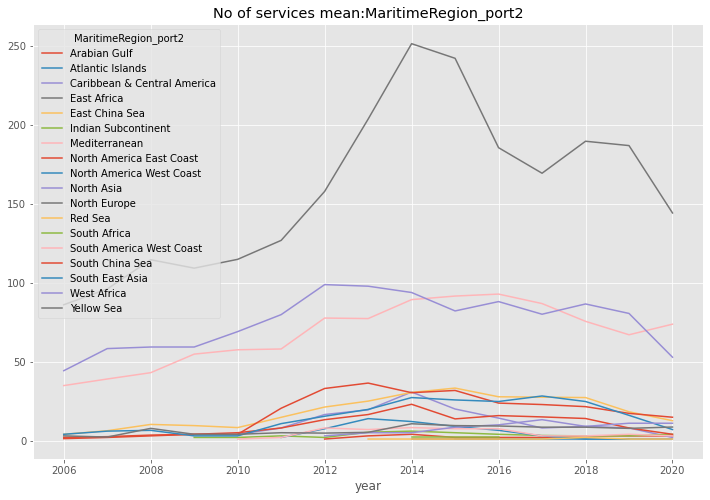

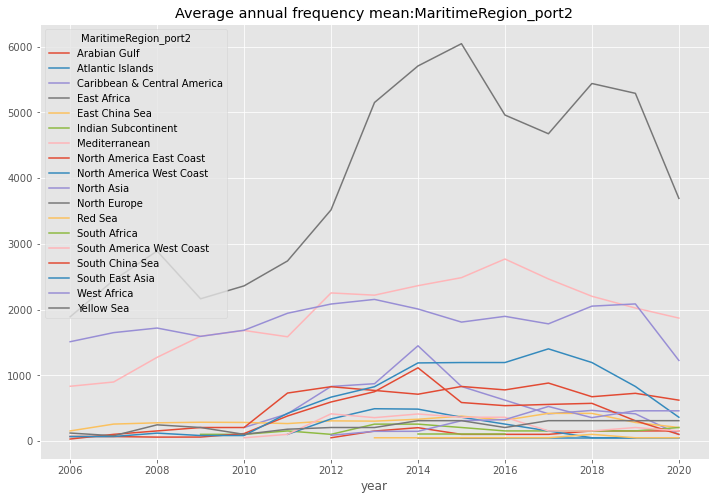

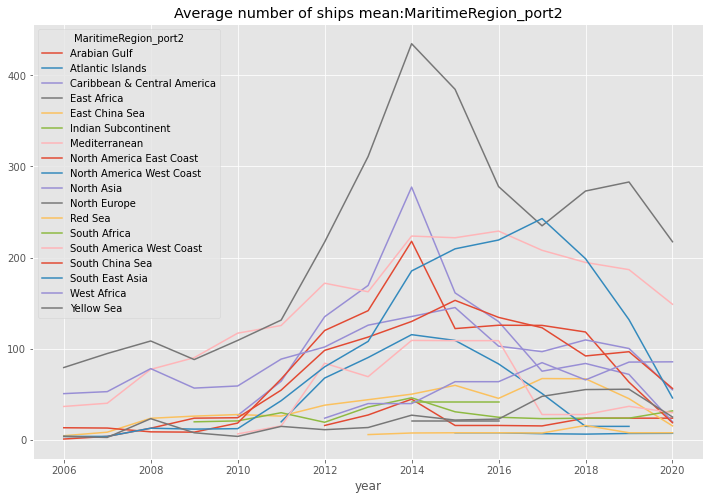

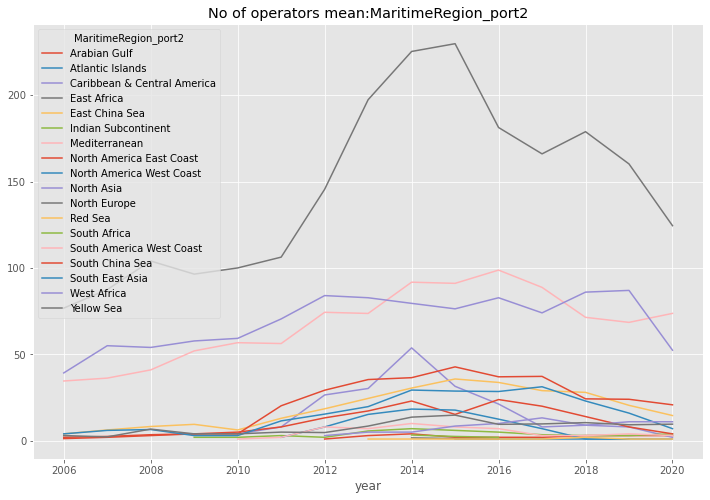

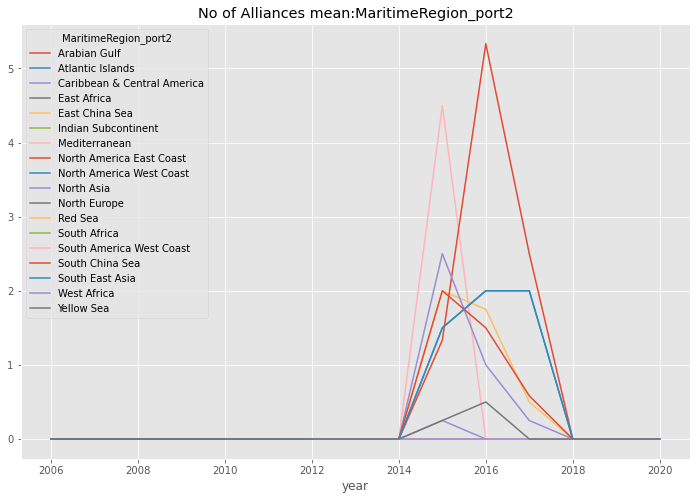

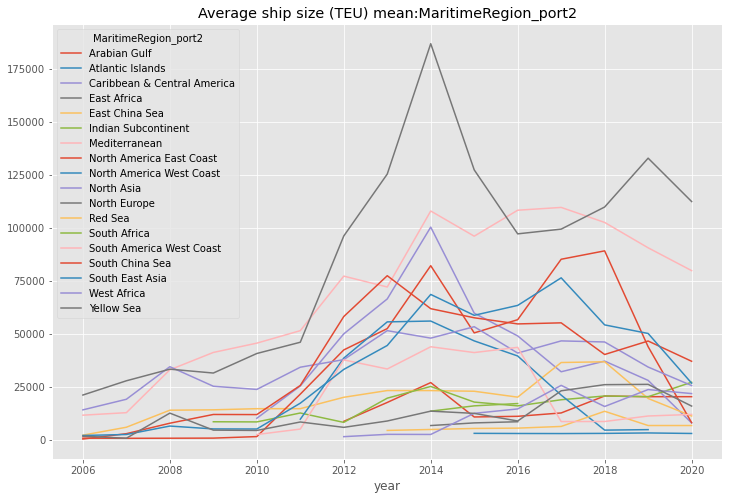

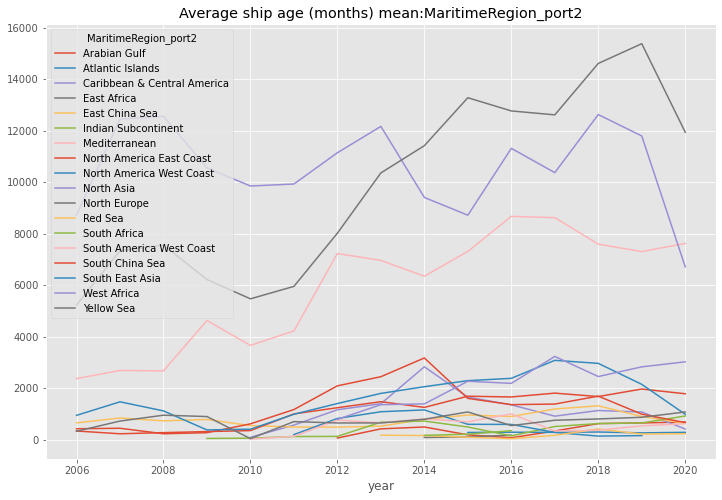

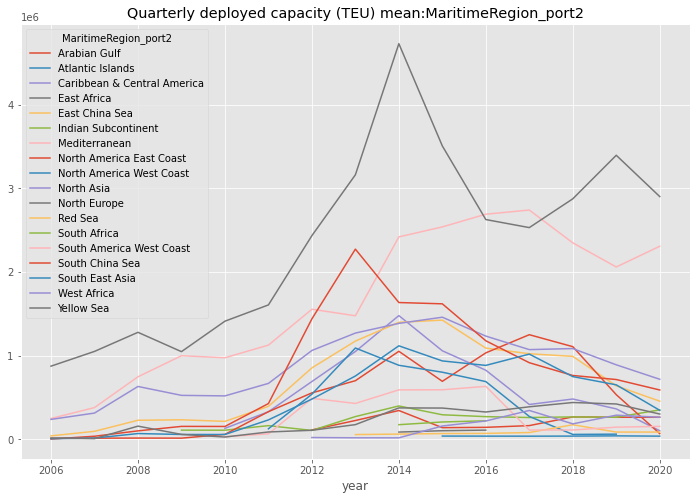

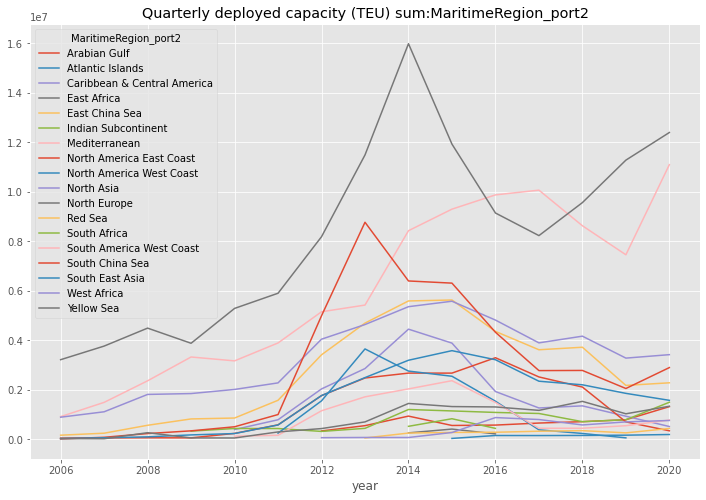

In [232]:
for n in num_columns:
    for c in cat_columns:
        reg_con = ru.groupby([c,'year'])[n].sum().reset_index()
        reg_con = reg_con.pivot(index='year', columns=c, values=n)
        reg_con.plot()
        plt.title("{}:{}".format(n,c))

In [233]:
ru.to_csv("Russia_ego_radius1.csv")

In [ ]:
G = nx.Graph()

In [225]:
reg_con = ru.groupby(["MaritimeRegion_port2",'year'])['Quarterly deployed capacity (TEU) sum'].sum().reset_index()

<AxesSubplot:xlabel='year'>

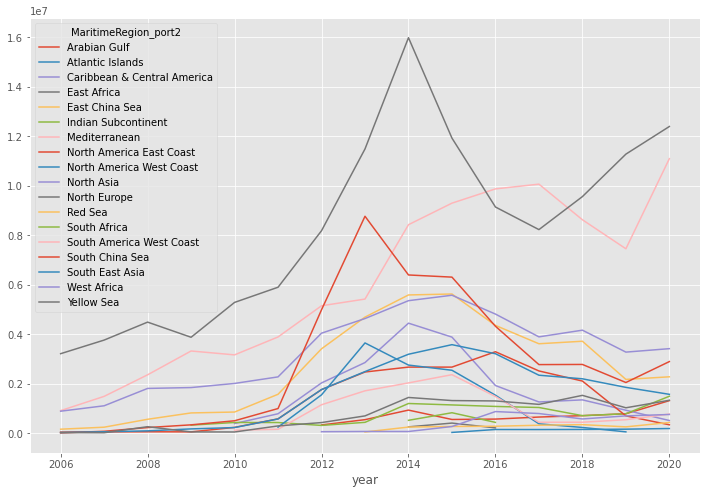

In [226]:
reg_con = reg_con.pivot(index='year', columns='MaritimeRegion_port2', values='Quarterly deployed capacity (TEU) sum')

reg_con.plot()